# 1. Preparation

In [1]:
import pandas as pd
import numpy as np
import warnings
import torch
from torch import nn
from torch.nn import functional as F
import plotly.express as px
import plotly.graph_objects as go
import networkx as nx
import pickle
import os
import gc
import re
import random
import lightgbm as lgb
from tqdm import tqdm
from sklearn.preprocessing import LabelEncoder
from transformers import AutoTokenizer, AutoModel
from torch.utils.data import DataLoader, TensorDataset, random_split
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.model_selection import train_test_split as tts

warnings.simplefilter("ignore")
pd.options.display.max_columns=100
pd.options.display.max_rows=100
torch.autograd.set_detect_anomaly(True)

seed = 0
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cudnn.deterministic = True
torch.use_deterministic_algorithms = True

device = "cuda" if torch.cuda.is_available() else "cpu"
%env TOKENIZERS_PARALLELISM=true
%env CUDA_LAUNCH_BLOCKING=1

Duplicate key in file PosixPath('/opt/conda/lib/python3.10/site-packages/matplotlib/mpl-data/matplotlibrc'), line 786 ('font.family:  IPAexGothic')
Duplicate key in file PosixPath('/opt/conda/lib/python3.10/site-packages/matplotlib/mpl-data/matplotlibrc'), line 787 ('figure.figsize: 16.4, 12.3')
Duplicate key in file PosixPath('/opt/conda/lib/python3.10/site-packages/matplotlib/mpl-data/matplotlibrc'), line 788 ('figure.dpi: 150')


env: TOKENIZERS_PARALLELISM=true
env: CUDA_LAUNCH_BLOCKING=1


In [2]:
class CFG:
    INPUT = "../data/"
    MODEL = "sentence-transformers/paraphrase-multilingual-mpnet-base-v2"#"sbert-models/paraphrase-multilingual-mpnet-base-v2"
    MAX_LEN = 512
    BATCH_SIZE = 2**7
    EPOCHS = 50
    THRESHOLD = .5
    EARLY_STOPPING_ROUNDS = 5

In [3]:
content = pd.read_csv(f'{CFG.INPUT}/content.csv')
correlations = pd.read_csv(f'{CFG.INPUT}/correlations.csv')
topics = pd.read_csv(f'{CFG.INPUT}/topics.csv')
sample_submission = pd.read_csv(f'{CFG.INPUT}/sample_submission.csv')

t_le = LabelEncoder()
topics_all = list(set(correlations.topic_id) | set(topics.id) | set(topics.parent)) + ["None"]
topics_all_enc = t_le.fit_transform(topics_all)
topics.id = t_le.transform(topics.id)
topics.parent = t_le.transform(topics.parent.fillna("None"))
correlations.topic_id = t_le.transform(correlations.topic_id)

c_le = LabelEncoder()
content.id = c_le.fit_transform(content.id)

target_topics = sample_submission.topic_id
target_topics_enc = t_le.transform(target_topics)

content.head()
correlations.head()
topics.head()
sample_submission.head()

,id,title,description,kind,text,language,copyright_holder,license
0,0,"Sumar números de varios dígitos: 48,029+233,930","Suma 48,029+233,930 mediante el algoritmo está...",video,NaN,es,NaN,NaN
1,1,Trovare i fattori di un numero,Sal trova i fattori di 120.\n\n,video,NaN,it,NaN,NaN
2,2,Sumar curvas de demanda,Cómo añadir curvas de demanda\n\n,video,NaN,es,NaN,NaN
3,3,Nado de aproximação,Neste vídeo você vai aprender o nado de aproxi...,document,\nNado de aproximação\nSaber nadar nas ondas ...,pt,Sikana Education,CC BY-NC-ND
4,4,geometry-m3-topic-a-overview.pdf,geometry-m3-topic-a-overview.pdf,document,Estándares Comunes del Estado de Nueva York\n\...,es,Engage NY,CC BY-NC-SA


,topic_id,content_ids
0,2,c_1108dd0c7a5d c_376c5a8eb028 c_5bc0e1e2cba0 c...
1,4,c_639ea2ef9c95 c_89ce9367be10 c_ac1672cdcd2c c...
2,5,c_11a1dc0bfb99
3,6,c_0c6473c3480d c_1c57a1316568 c_5e375cf14c47 c...
4,7,c_34e1424229b4 c_7d1a964d66d5 c_aab93ee667f4


,id,title,description,channel,category,level,language,parent,has_content
0,2,Откриването на резисторите,"Изследване на материали, които предизвикват на...",000cf7,source,4,bg,6807,True
1,3,Unit 3.3 Enlargements and Similarities,NaN,b3f329,aligned,2,en,50876,False
2,4,Entradas e saídas de uma função,Entenda um pouco mais sobre funções.,8e286a,source,4,pt,62630,True
3,5,Transcripts,NaN,6e3ba4,source,3,en,19138,True
4,6,Графики на експоненциални функции (Алгебра 2 н...,Научи повече за графиките на сложните показате...,000cf7,source,4,bg,67917,True


,topic_id,content_ids
0,t_00004da3a1b2,c_1108dd0c7a5d c_376c5a8eb028 c_5bc0e1e2cba0 c...
1,t_00068291e9a4,c_639ea2ef9c95 c_89ce9367be10 c_ac1672cdcd2c c...
2,t_00069b63a70a,c_11a1dc0bfb99
3,t_0006d41a73a8,c_0c6473c3480d c_1c57a1316568 c_5e375cf14c47 c...
4,t_4054df11a74e,c_3695c5dc1df6 c_f2d184a98231


# 2. EDA

## 2.1. topics

### 2.1.1. fundamental checking

Numbers of topics:  76972

Null Check.


,index,0
0,id,0
1,title,2
2,description,42019
3,channel,0
4,category,0
5,level,0
6,language,0
7,parent,0
8,has_content,0



Topic Title Duplicated.


31889


Topic Description Duplicated.


53904

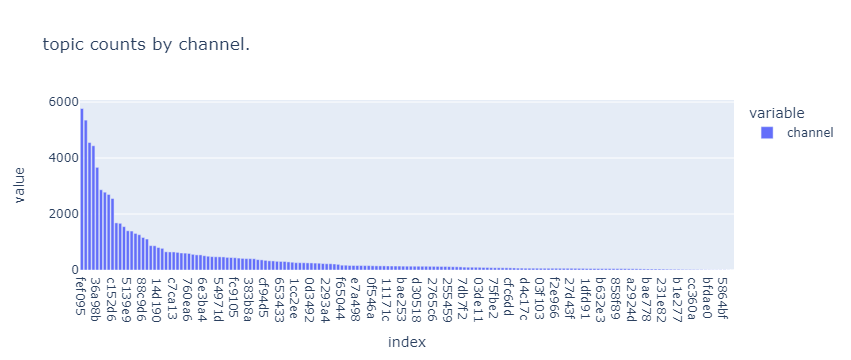

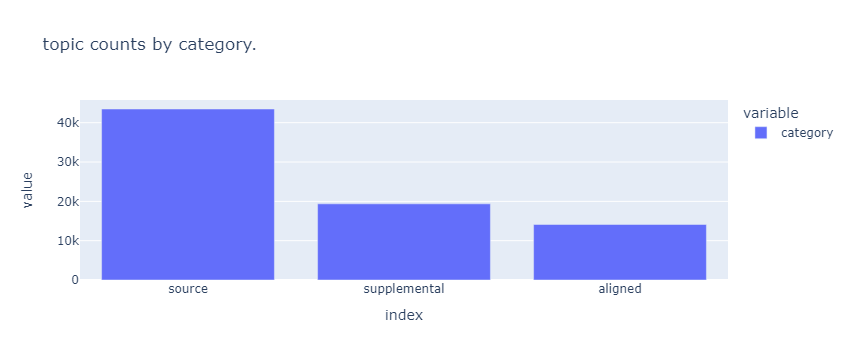

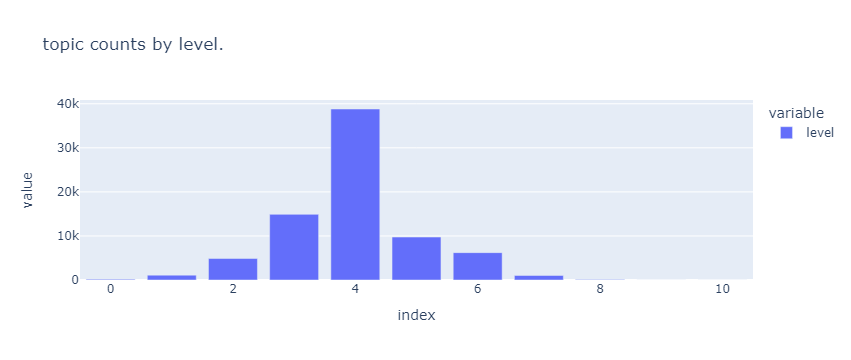

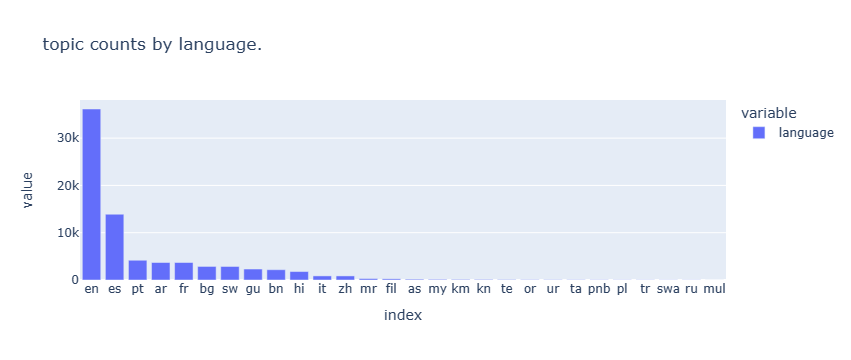

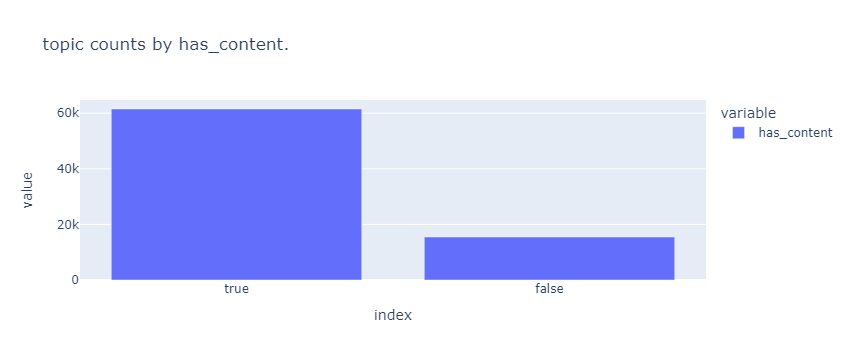

In [4]:
print("Numbers of topics: ", len(topics))

print("\nNull Check.")
topics.isnull().sum().reset_index()

print("\nTopic Title Duplicated.")
topics.title.duplicated().sum()

print("\nTopic Description Duplicated.")
topics.description.duplicated().sum()

for var in ["channel", "category", "level", "language", "has_content"]:
    px.bar(topics[var].value_counts(dropna=False), title=f"topic counts by {var}.")

### 2.1.2. Network between topics

#### network analysis

In [135]:
%%time

pickle_path = f"{CFG.INPUT}/G.pickle"

if os.path.exists(pickle_path):
    with open(pickle_path, 'rb') as f:
        G = pickle.load(f)
else:
    G = nx.DiGraph()
    for node in list(topics_all_enc):
      G.add_node(node)
    print("Added all nodes!")

    for i, row in topics[topics.parent.notnull()][["id", "parent"]].iterrows():
        G.add_edge(row.parent, row.id)
    print("Added all edges!")

    pos = nx.spring_layout(G, k=30, seed=1)
    for node, p in pos.items():
        G._node[node]["pos"] = p
        
    with open(pickle_path, 'wb') as f:
        pickle.dump(G, f)

Added all nodes!
Added all edges!
CPU times: user 3h 5min 10s, sys: 1.34 s, total: 3h 5min 12s
Wall time: 3h 5min 15s


In [136]:
%%time

with open(f"{CFG.INPUT}/G.pickle", 'wb') as p:
    pickle.dump(G, p)

CPU times: user 779 ms, sys: 76 ms, total: 855 ms
Wall time: 855 ms


## 2.2. content

Numbers of content:  154047

Null Check.


,index,0
0,id,0
1,title,9
2,description,64591
3,kind,0
4,text,80012
5,language,0
6,copyright_holder,82226
7,license,80012



Content Title Duplicated.


23109


Content Description Duplicated.


77741

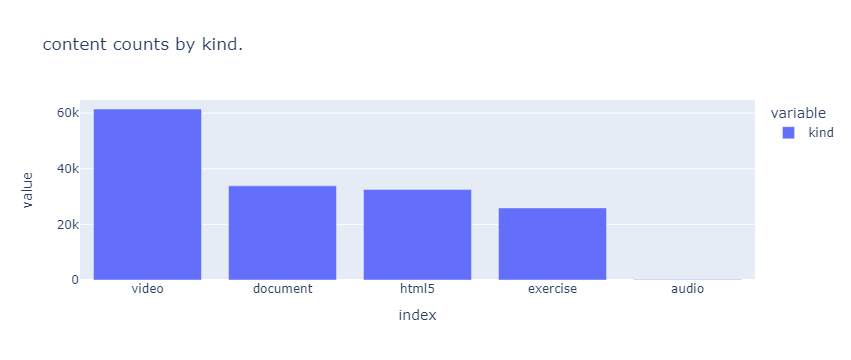

In [ ]:
print("Numbers of content: ", len(content))

print("\nNull Check.")
content.isnull().sum().reset_index()

print("\nContent Title Duplicated.")
content.title.duplicated().sum()

print("\nContent Description Duplicated.")
content.description.duplicated().sum()

for var in ["kind", "language", "copyright_holder", "license"]:
    px.bar(content[var].value_counts(dropna=False), title=f"content counts by {var}.")

## 2.3. correlations

In [4]:
correlations_transform = []
for i, row in correlations.iterrows():
    for c in row.content_ids.split(" "):
        correlations_transform.append((row.topic_id, c))

correlations_transform = pd.DataFrame(
    correlations_transform, columns=["topic_id", "content_id"]
)
correlations_transform.content_id = c_le.transform(correlations_transform.content_id)

correlations_transform = pd.merge(
    correlations_transform,
    content[["id", "kind", "language", "copyright_holder", "license"]].rename(
        columns={col:"c_"+col for col in content.columns if col != "id"} | {"id": "content_id"}
    ),
    how="left",
    on="content_id",
)

correlations_transform = pd.merge(
    correlations_transform,
    topics[["id", "category",	"level", "language", "has_content"]].rename(
        columns={col:"t_"+col for col in topics.columns if col != "id"} | {"id": "topic_id"}
    ),
    how="left",
    on="topic_id",
)

correlations_transform

,topic_id,content_id,c_kind,c_language,c_copyright_holder,c_license,t_category,t_level,t_language,t_has_content
0,2,10216,video,bg,NaN,NaN,source,4,bg,True
1,2,33412,video,bg,NaN,NaN,source,4,bg,True
2,2,55283,video,bg,NaN,NaN,source,4,bg,True
3,2,70957,video,bg,NaN,NaN,source,4,bg,True
4,4,59982,exercise,pt,NaN,NaN,source,4,pt,True
...,...,...,...,...,...,...,...,...,...,...
279914,76968,128968,html5,es,NaN,NaN,supplemental,2,es,True
279915,76970,42862,video,sw,NaN,NaN,source,4,sw,True
279916,76970,61621,video,sw,NaN,NaN,source,4,sw,True
279917,76971,124451,document,es,NaN,NaN,aligned,6,es,True


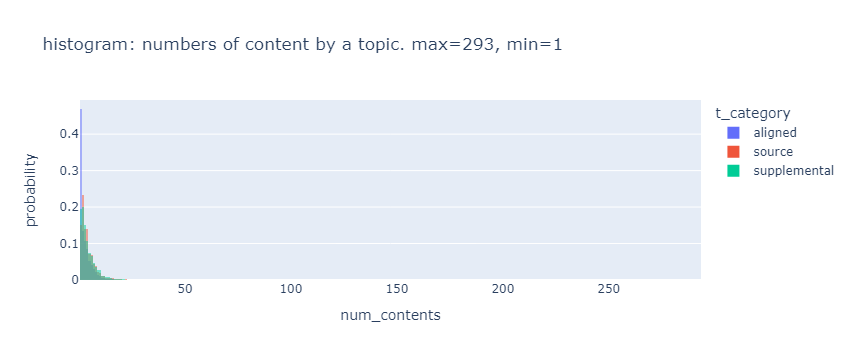

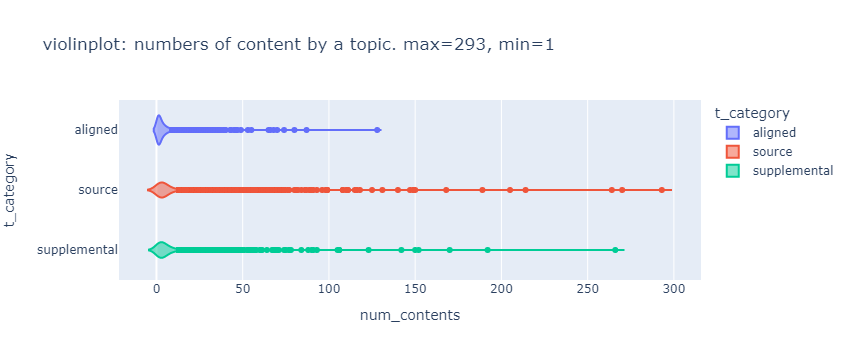

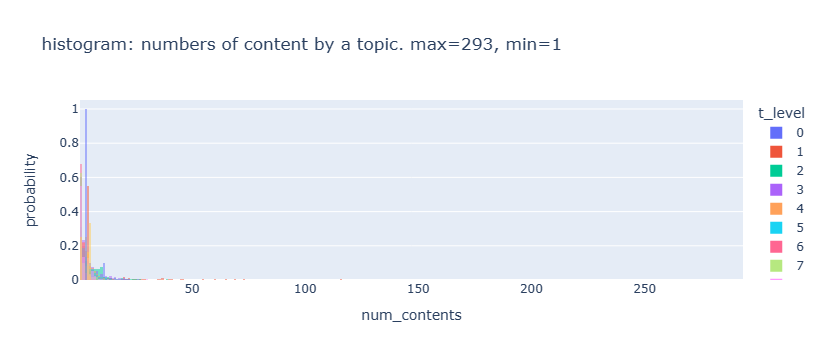

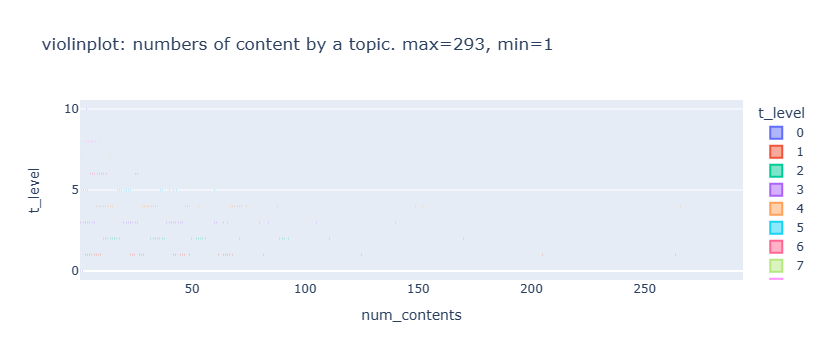

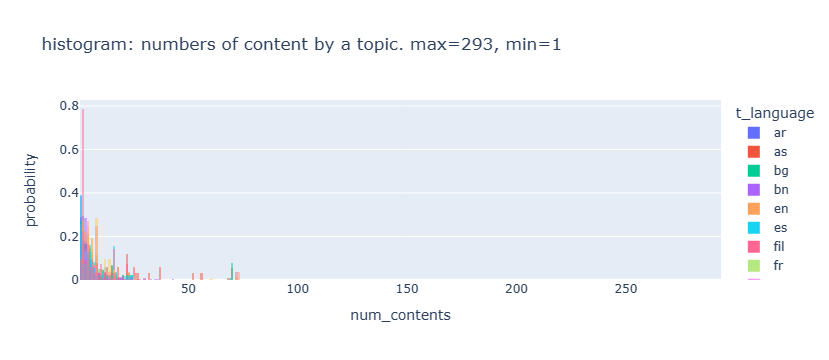

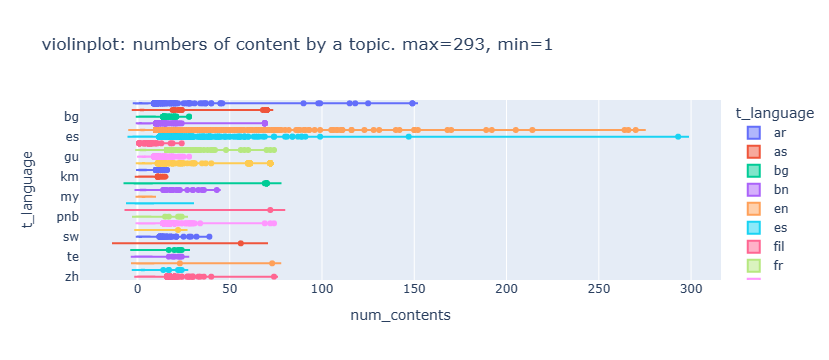

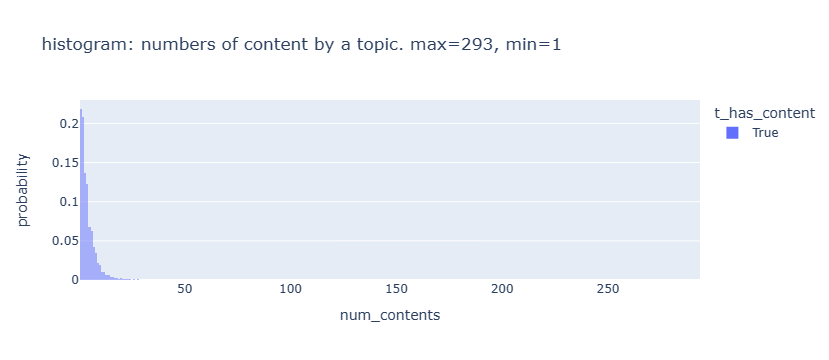

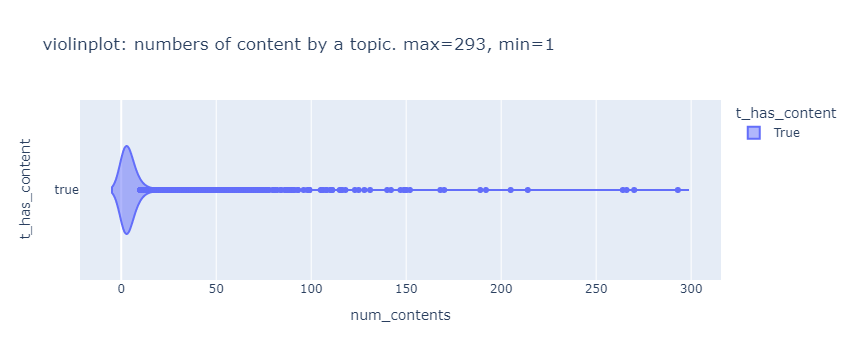

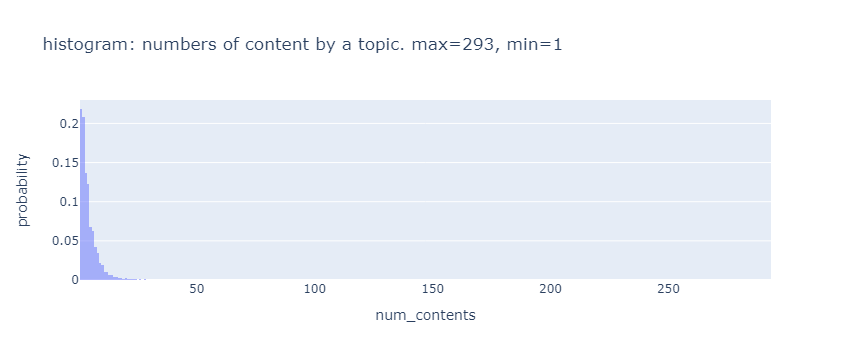

In [24]:
for var in [col for col in correlations_transform.columns if col.startswith("t_")]:
    
    agg = correlations_transform.groupby([var, "topic_id"]).agg(
        num_contents=("content_id", "count")
    )
    px.histogram(
        data_frame = agg.reset_index(),
        x = "num_contents",
        barmode="overlay",
        histnorm='probability',
        color=var,
        title=f"histogram: numbers of content by a topic. max={agg.max().values[0]}, min={agg.min().values[0]}",
    )

    px.violin(
        data_frame = agg.reset_index(),
        x = "num_contents",
        y=var,
        color=var,
        title=f"violinplot: numbers of content by a topic. max={agg.max().values[0]}, min={agg.min().values[0]}",
    )

agg = correlations_transform.groupby(["topic_id"]).agg(
    num_contents=("content_id", "count")
)
px.histogram(
    data_frame = agg.reset_index(),
    x = "num_contents",
    barmode="overlay",
    histnorm='probability',
    title=f"histogram: numbers of content by a topic. max={agg.max().values[0]}, min={agg.min().values[0]}",
)

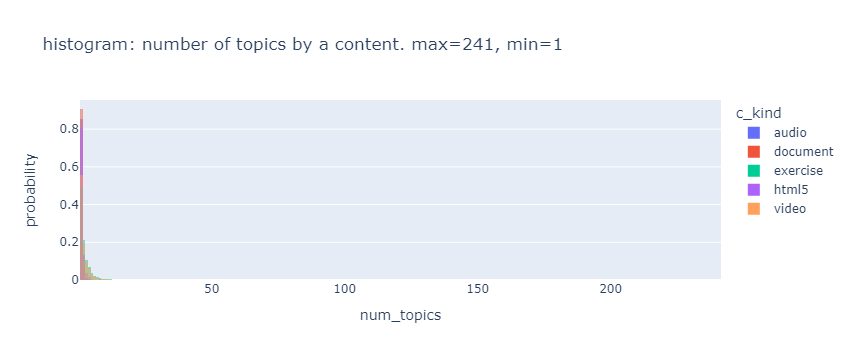

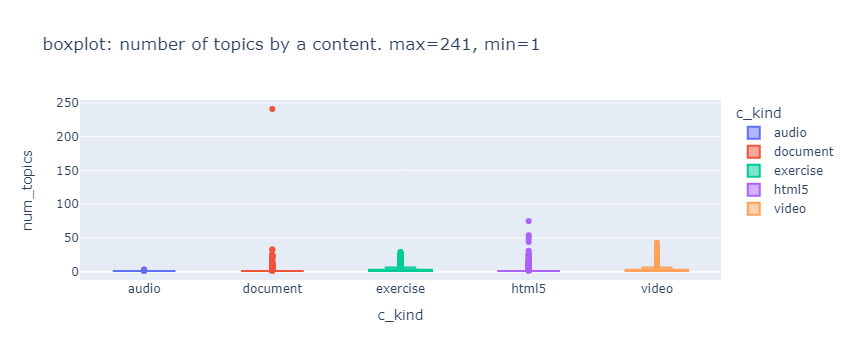

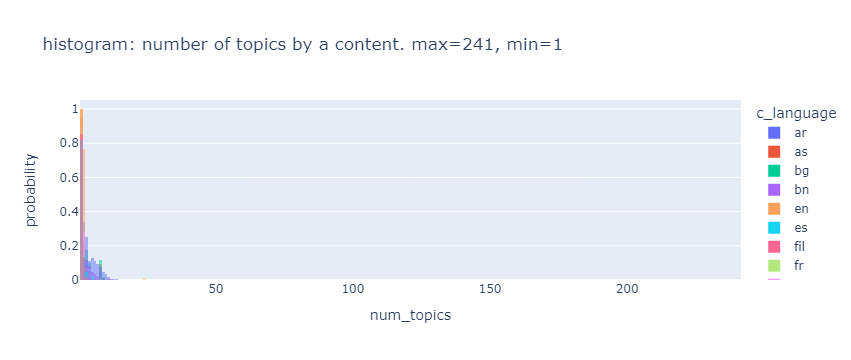

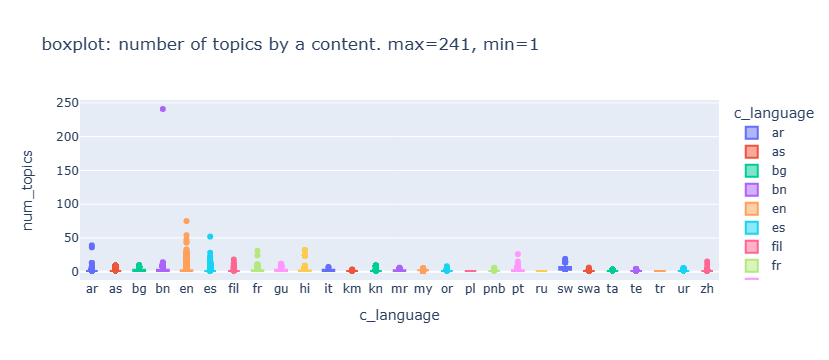

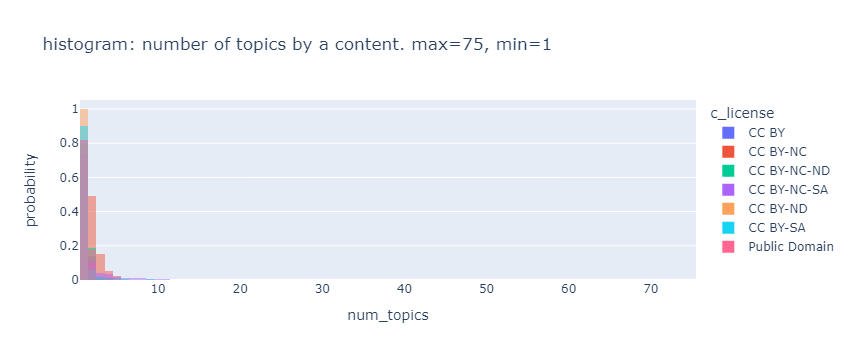

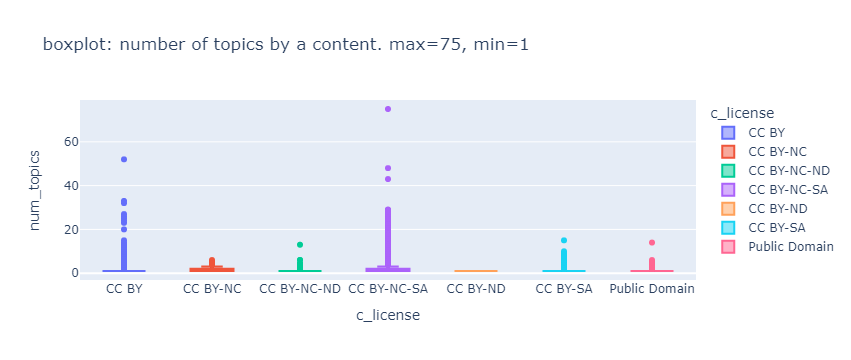

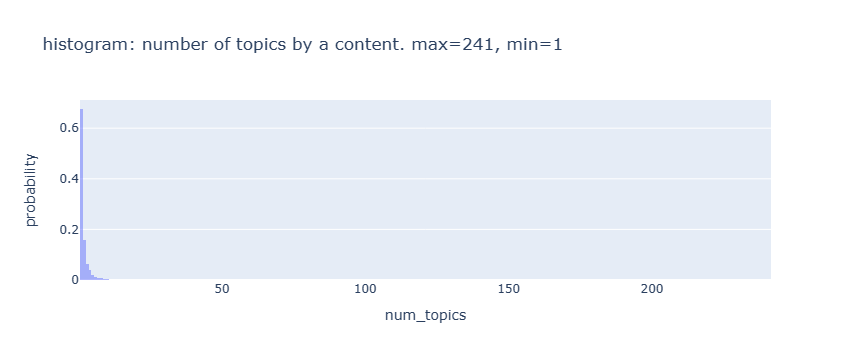

In [31]:
for var in [col for col in correlations_transform.columns if col.startswith("c_") and col != "c_copyright_holder"]:
    
    agg = correlations_transform.groupby([var, "content_id"]).agg(
        num_topics=("topic_id", "count")
    )
    px.histogram(
        data_frame = agg.reset_index(),
        x = "num_topics",
        barmode="overlay",
        histnorm='probability',
        color=var,
        title=f"histogram: number of topics by a content. max={agg.max().values[0]}, min={agg.min().values[0]}",
    )
    px.box(
        data_frame = agg.reset_index(),
        y = "num_topics",
        x = var,
        color=var,
        title=f"boxplot: number of topics by a content. max={agg.max().values[0]}, min={agg.min().values[0]}",
    )

agg = correlations_transform.groupby(["content_id"]).agg(
    num_topics=("topic_id", "count")
)
px.histogram(
    data_frame = agg.reset_index(),
    x = "num_topics",
    barmode="overlay",
    histnorm='probability',
    title=f"histogram: number of topics by a content. max={agg.max().values[0]}, min={agg.min().values[0]}",
)

In [78]:
agg = pd.crosstab(correlations_transform.t_language, columns=correlations_transform.c_language)
agg.shape
agg

(27, 27)

c_language,ar,as,bg,bn,en,es,fil,fr,gu,hi,it,km,kn,mr,my,or,pl,pnb,pt,ru,sw,swa,ta,te,tr,ur,zh
t_language,,,,,,,,,,,,,,,,,,,,,,,,,,,
ar,9203,0,0,0,257,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
as,0,1212,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
bg,0,0,13150,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
bn,0,0,0,6843,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
en,54,0,0,0,127534,44,0,0,0,4,0,0,5,0,0,0,0,0,49,0,0,0,0,0,0,10,37
es,1,0,0,0,611,46294,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
fil,0,0,0,0,0,0,666,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
fr,0,0,0,0,0,0,0,18562,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
gu,0,0,0,0,0,0,0,0,7548,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## memo
+ Task1: How many topics do each content belong to?(from 1 to 241)
+ Task2: How many contents do each topic have? (from 1 to 293)
+ Task3: Which contents do each topic have?

In [5]:
text_cols = ["title", "description", "text"]
agg = correlations_transform.groupby(["content_id"]).agg(
    num_topics=("topic_id", "count")
).reset_index().rename(columns={"content_id":"id"})
content_rev = pd.merge(content, agg, how="left", on="id").drop(text_cols, axis=1)
content_rev.num_topics = content_rev.num_topics.fillna(0)
content_rev["text"] = content.title.fillna("") + \
    "\n" + content.description.fillna("") + \
    "\n" + content.text.fillna("")
content_rev

text_cols = ["title", "description"]
agg = correlations_transform.groupby(["topic_id"]).agg(
    num_contents=("content_id", "count")
).fillna(0).reset_index().rename(columns={"topic_id":"id"})
topics_rev = pd.merge(topics, agg, how="left", on="id").drop(text_cols, axis=1)
topics_rev.num_contents = topics_rev.num_contents.fillna(0)
topics_rev["text"] = topics.title.fillna("") + "\n" + topics.description.fillna("")

topics_rev

,id,kind,language,copyright_holder,license,num_topics,text
0,0,video,es,NaN,NaN,5,"Sumar números de varios dígitos: 48,029+233,93..."
1,1,video,it,NaN,NaN,2,Trovare i fattori di un numero\nSal trova i fa...
2,2,video,es,NaN,NaN,1,Sumar curvas de demanda\nCómo añadir curvas de...
3,3,document,pt,Sikana Education,CC BY-NC-ND,1,Nado de aproximação\nNeste vídeo você vai apre...
4,4,document,es,Engage NY,CC BY-NC-SA,2,geometry-m3-topic-a-overview.pdf\ngeometry-m3-...
...,...,...,...,...,...,...,...
154042,154042,html5,en,CSU and Merlot,CC BY-NC-SA,1,2. 12: Diffusion\n\nWhat will eventually happe...
154043,154043,video,it,NaN,NaN,6,Sommare facendo gruppi da 10\nSal somma 5+68 s...
154044,154044,video,pt,NaN,NaN,3,Introdução à subtração\nSal fala sobre o que s...
154045,154045,video,en,NaN,NaN,1,SA of a Cone\n\n


,id,channel,category,level,language,parent,has_content,num_contents,text
0,2,000cf7,source,4,bg,6807,True,4.0,Откриването на резисторите\nИзследване на мате...
1,3,b3f329,aligned,2,en,50876,False,0.0,Unit 3.3 Enlargements and Similarities\n
2,4,8e286a,source,4,pt,62630,True,4.0,Entradas e saídas de uma função\nEntenda um po...
3,5,6e3ba4,source,3,en,19138,True,1.0,Transcripts\n
4,6,000cf7,source,4,bg,67917,True,5.0,Графики на експоненциални функции (Алгебра 2 н...
...,...,...,...,...,...,...,...,...,...
76967,76969,e77b55,aligned,4,en,30911,False,0.0,4.3 Graph of functions\n
76968,76970,0c929f,source,4,sw,23831,True,2.0,Inscribed shapes problem solving\nUse properti...
76969,76971,6e90a7,aligned,6,es,63542,True,1.0,Lección 7\n
76970,76972,9fd860,source,2,ar,27260,True,1.0,تحديد العلاقة بين الإحداثيّات القطبية والإحداث...


# 3. Training

## 3.0.Feature Engineering

### 3.0.1. Text Embedding

In [11]:
%%time
gc.collect()

model = AutoModel.from_pretrained(CFG.MODEL)
tokenizer = AutoTokenizer.from_pretrained(CFG.MODEL)
model.eval();
model.to(device);

def distributed_representations(data):
    distributed_representations = []

    for text in data:
        tok = tokenizer(text, max_length=CFG.MAX_LEN, padding=True, truncation=True, return_tensors='pt')
        with torch.no_grad():
            embedding = model(tok.input_ids.to(device), tok.attention_mask.to(device)).last_hidden_state
        embedding = torch.mean(embedding, dim=1)[0].cpu()
        distributed_representations += [embedding]
    distributed_representations = torch.stack(distributed_representations)
    return distributed_representations

if not os.path.exists(f"{CFG.INPUT}/dr_topics.pickle"):
    %time dr_topics = distributed_representations(topics_rev.text) # Wall time: 7min 27s
    with open(f"{CFG.INPUT}/dr_topics.pickle", 'wb') as p:
        pickle.dump(dr_topics, p)
else:
    with open(f"{CFG.INPUT}/dr_topics.pickle", 'rb') as f:
        dr_topics = pickle.load(f)

if not os.path.exists(f"{CFG.INPUT}/dr_content.pickle"):
    %time dr_content = distributed_representations(content_rev.text) # Wall time: 44min 49s
    with open(f"{CFG.INPUT}/dr_content.pickle", 'wb') as p:
        pickle.dump(dr_content, p)
else:
    with open(f"{CFG.INPUT}/dr_content.pickle", 'rb') as f:
        dr_content = pickle.load(f)

CPU times: user 4.22 s, sys: 1.96 s, total: 6.18 s
Wall time: 6.06 s


### 3.0.2. Analyze Channels

In [12]:
channel = topics_rev.groupby("channel").agg(ch_num_topics=("id", "count"))
channel = channel.join(topics_rev.groupby("channel").agg(ch_variety_lang=("language", "nunique")))
channel = channel.join(topics_rev.groupby("channel").agg(ch_max_level=("level", "max")))
channel = channel.join(topics_rev.groupby("channel").agg(ch_mean_level=("level", "mean")))
channel = channel.join(topics_rev.groupby("channel").agg(ch_std_level=("level", "std")))
channel = channel.reset_index()
channel

,channel,ch_num_topics,ch_variety_lang,ch_max_level,ch_mean_level,ch_std_level
0,000cf7,2867,1,4,3.824206,0.436234
1,00a2b4,215,1,4,3.637209,0.689380
2,00fda4,99,1,4,3.434343,0.810160
3,01133c,28,1,1,0.964286,0.188982
4,018d08,99,1,3,2.727273,0.549920
...,...,...,...,...,...,...
166,fc1d48,90,1,7,3.988889,1.820572
167,fc72b4,64,1,3,2.609375,0.657489
168,fc9105,439,1,9,4.804100,1.187023
169,fef095,5770,1,6,4.519931,0.921255


### 3.0.3. Contents: Copyright & Text Processing

In [13]:
new_copyright = []
for ch in content_rev.copyright_holder.fillna(""):
    res = re.search(r"\s\d{4}", ch)
    if res:
        holder = ch[:res.span()[0]+1] + ch[res.span()[1]:]
        year = res.group().strip()
        new_copyright.append((holder.strip(), year))
    else:
        if ch == "":
            ch = None
        new_copyright.append((ch, np.nan))

content_rev[["copyright_holder", "copyright_year"]] = pd.DataFrame(new_copyright)
content_rev["copyright_year"] = content_rev["copyright_year"].astype(float)
content_rev["words_text"] = [len(t) for t in content_rev.text.str.split(" ")]

content_rev

,id,kind,language,copyright_holder,license,num_topics,text,copyright_year,words_text
0,0,video,es,None,NaN,5,"Sumar números de varios dígitos: 48,029+233,93...",NaN,12
1,1,video,it,None,NaN,2,Trovare i fattori di un numero\nSal trova i fa...,NaN,11
2,2,video,es,None,NaN,1,Sumar curvas de demanda\nCómo añadir curvas de...,NaN,8
3,3,document,pt,Sikana Education,CC BY-NC-ND,1,Nado de aproximação\nNeste vídeo você vai apre...,NaN,331
4,4,document,es,Engage NY,CC BY-NC-SA,2,geometry-m3-topic-a-overview.pdf\ngeometry-m3-...,NaN,652
...,...,...,...,...,...,...,...,...,...
154042,154042,html5,en,CSU and Merlot,CC BY-NC-SA,1,2. 12: Diffusion\n\nWhat will eventually happe...,NaN,735
154043,154043,video,it,None,NaN,6,Sommare facendo gruppi da 10\nSal somma 5+68 s...,NaN,16
154044,154044,video,pt,None,NaN,3,Introdução à subtração\nSal fala sobre o que s...,NaN,17
154045,154045,video,en,None,NaN,1,SA of a Cone\n\n,NaN,4


### 3.0.4. Topics: Text Processing

In [14]:
topics_rev["words_text"] = [len(t) for t in topics_rev.text.str.split(" ")]
topics_rev

,id,channel,category,level,language,parent,has_content,num_contents,text,words_text
0,2,000cf7,source,4,bg,6807,True,4.0,Откриването на резисторите\nИзследване на мате...,19
1,3,b3f329,aligned,2,en,50876,False,0.0,Unit 3.3 Enlargements and Similarities\n,5
2,4,8e286a,source,4,pt,62630,True,4.0,Entradas e saídas de uma função\nEntenda um po...,11
3,5,6e3ba4,source,3,en,19138,True,1.0,Transcripts\n,1
4,6,000cf7,source,4,bg,67917,True,5.0,Графики на експоненциални функции (Алгебра 2 н...,17
...,...,...,...,...,...,...,...,...,...,...
76967,76969,e77b55,aligned,4,en,30911,False,0.0,4.3 Graph of functions\n,4
76968,76970,0c929f,source,4,sw,23831,True,2.0,Inscribed shapes problem solving\nUse properti...,23
76969,76971,6e90a7,aligned,6,es,63542,True,1.0,Lección 7\n,2
76970,76972,9fd860,source,2,ar,27260,True,1.0,تحديد العلاقة بين الإحداثيّات القطبية والإحداث...,7


## 3.1. Task1: How many topics do each content belong to?

### 3.1.1. Data Preparation

In [15]:
task1y = content_rev.num_topics.copy()
task1X = content_rev.drop(["text", "num_topics"], axis=1).set_index("id").fillna(0)
task1X = pd.get_dummies(task1X, columns=["kind", "language", "copyright_holder", "license"], dummy_na=True)

task1y = torch.Tensor(task1y.values)
task1X = torch.Tensor(task1X.values)
task1X_backup = task1X.clone()
task1X = torch.cat([task1X, dr_content], dim=1)

all_idx = range(len(task1y))
train_idx = random.sample(all_idx, int(len(task1y)*0.8))
test_idx = list(set(all_idx) - set(train_idx))

task1X

tensor([[ 0.0000e+00,  1.2000e+01,  0.0000e+00,  ...,  1.5955e-01,
          7.2962e-02, -7.4636e-02],
        [ 0.0000e+00,  1.1000e+01,  0.0000e+00,  ...,  1.7195e-01,
         -3.3331e-02, -1.0057e-01],
        [ 0.0000e+00,  8.0000e+00,  0.0000e+00,  ..., -5.7392e-03,
         -2.2839e-01, -1.2480e-01],
        ...,
        [ 0.0000e+00,  1.7000e+01,  0.0000e+00,  ...,  7.4601e-02,
          8.9372e-02, -3.6883e-02],
        [ 0.0000e+00,  4.0000e+00,  0.0000e+00,  ...,  7.8134e-02,
          8.5173e-02, -4.3908e-02],
        [ 0.0000e+00,  2.0000e+00,  0.0000e+00,  ...,  2.3811e-01,
          6.2334e-02, -1.1432e-01]])

### 3.2.1. Modeling

#### 3.2.1.1. LightGBM

In [59]:
train_lgb = lgb.Dataset(task1X[train_idx].numpy(), task1y[train_idx].numpy())
eval_lgb = lgb.Dataset(task1X[test_idx].numpy(), task1y[test_idx].numpy())

params_lgb = dict(
            task="train",
            boosting_type="gbdt",
            objective="regression",
            metric="rmse",
            learning_rate=.05,
            force_col_wise=True,
            device='cpu',
            num_leaves=700,
            max_iter=2000,
            seed=seed,
            lambda_l1=.1,
            lambda_l2=.1,
            bagging_freq=10,
            bagging_seed=seed,
        )

evals_result = {}

model_lgb = lgb.train(
    params=params_lgb,
    train_set=train_lgb,
    valid_names=['train', 'valid'],
    valid_sets=[train_lgb, eval_lgb],
    early_stopping_rounds=20,
    evals_result=evals_result,
    #verbose_eval=self.verbose
)

preds_lgb = model_lgb.predict(task1X[test_idx].numpy())
res = mse(preds_lgb, task1y[test_idx].numpy())**.5
res

[LightGBM] [Info] Total Bins 196273
[LightGBM] [Info] Number of data points in the train set: 123237, number of used features: 854
[LightGBM] [Info] Start training from score 1.817814
[1]	train's rmse: 1.98026	valid's rmse: 1.85879
Training until validation scores don't improve for 20 rounds
[2]	train's rmse: 1.93353	valid's rmse: 1.82432
[3]	train's rmse: 1.89016	valid's rmse: 1.7939
[4]	train's rmse: 1.84912	valid's rmse: 1.7656
[5]	train's rmse: 1.80944	valid's rmse: 1.73938
[6]	train's rmse: 1.7725	valid's rmse: 1.71613
[7]	train's rmse: 1.73778	valid's rmse: 1.69413
[8]	train's rmse: 1.70408	valid's rmse: 1.6719
[9]	train's rmse: 1.6721	valid's rmse: 1.65173
[10]	train's rmse: 1.64239	valid's rmse: 1.63412
[11]	train's rmse: 1.61379	valid's rmse: 1.61636
[12]	train's rmse: 1.58657	valid's rmse: 1.601
[13]	train's rmse: 1.56064	valid's rmse: 1.5862
[14]	train's rmse: 1.53609	valid's rmse: 1.57307
[15]	train's rmse: 1.513	valid's rmse: 1.56072
[16]	train's rmse: 1.49078	valid's rmse

1.37925663049091

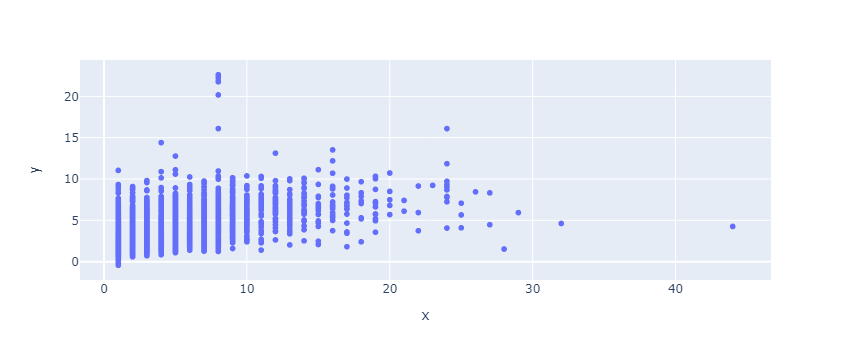

In [61]:
px.scatter(y=preds_lgb, x=task1y[test_idx].numpy())

## 3.2. Task2: How many contents do each topic have?

### 3.2.1. Data Preparation

In [81]:
task2y = topics_rev[topics_rev.has_content].num_contents.copy()
task2X = pd.merge(topics_rev, channel, how="left", on="channel")
task2X = task2X.drop(["channel", "num_contents", "text", "parent", "has_content"], axis=1).set_index("id")
task2X = pd.get_dummies(task2X, columns=["category", "language"], dummy_na=True).fillna(0)
task2X_backup = task2X.copy()

task2y = torch.Tensor(task2y.values)
task2X = torch.Tensor(task2X.values)[topics_rev.has_content]
#task2X = torch.cat([task2X, dr_topics[topics_rev.has_content]], dim=1)

task2_dataset = TensorDataset(dr_topics[topics_rev.has_content], task2X, task2y)
num_train = int(task2y.shape[0]*.9)
task2_train, task2_test = random_split(task2_dataset, [num_train, task2y.shape[0]-num_train])
task2_train_loader = DataLoader(task2_train, batch_size=CFG.BATCH_SIZE, shuffle=True)
task2_test_loader = DataLoader(task2_test, batch_size=CFG.BATCH_SIZE, shuffle=True)

### 3.2.2. Modeling

#### 3.2.2.1. Pytorch

In [125]:
%%time

class Task2(nn.Module):
    def __init__(self, text_features, normal_features):
        super().__init__()

        self.units_text = [text_features,512,256,256,64,128,32]
        self.units_normal = [normal_features,512,256,256,64,128,32]
        self.units_concated = [self.units_text[-1]+self.units_normal[-1],128,256,256,64,128,32]
        
        self.text_l1_bn = nn.BatchNorm1d(self.units_text[0])
        self.text_l1 = nn.Linear(self.units_text[0], self.units_text[1])
        nn.init.xavier_normal_(self.text_l1.weight)
        self.text_bn = nn.ModuleList([nn.BatchNorm1d(self.units_text[i+1]) for i in range(len(self.units_text)-2)])
        self.text = nn.ModuleList([nn.Linear(self.units_text[i+1], self.units_text[i+2]) for i in range(len(self.units_text)-2)])
        
        self.normal_l1_bn = nn.BatchNorm1d(self.units_normal[0])
        self.normal_l1 = nn.Linear(self.units_normal[0], self.units_normal[1])
        nn.init.xavier_normal_(self.normal_l1.weight)
        self.normal_bn = nn.ModuleList([nn.BatchNorm1d(self.units_normal[i+1]) for i in range(len(self.units_normal)-2)])
        self.normal = nn.ModuleList([nn.Linear(self.units_normal[i+1], self.units_normal[i+2]) for i in range(len(self.units_normal)-2)])

        self.concated_l1_bn = nn.BatchNorm1d(self.units_concated[0])
        self.concated_l1 = nn.Linear(self.units_concated[0], self.units_concated[1])
        nn.init.xavier_normal_(self.concated_l1.weight)
        self.concated_bn = nn.ModuleList([nn.BatchNorm1d(self.units_concated[i+1]) for i in range(len(self.units_concated)-2)])
        self.concated = nn.ModuleList([nn.Linear(self.units_concated[i+1], self.units_concated[i+2]) for i in range(len(self.units_concated)-2)])
        self.concated_last_layer = nn.Linear(self.units_concated[-1], 1)
        self.concated_last_layer_bn = nn.BatchNorm1d(self.units_concated[-1])
        
    def forward(self, text, normal):
        """
        text features network
        """
        text = F.leaky_relu(self.text_l1(self.text_l1_bn(text)))
        for l, b in zip(self.text, self.text_bn):
            text = F.leaky_relu(l(b(text)))
        
        """
        normal features network
        """
        normal = F.leaky_relu(self.normal_l1(self.normal_l1_bn(normal)))
        for l, b in zip(self.normal, self.normal_bn):
            normal = F.leaky_relu(l(b(normal)))
            
        """
        concated network
        """
        x = torch.cat([text, normal], dim=1)
        x = F.leaky_relu(self.concated_l1(self.concated_l1_bn(x)))
        for l, b in zip(self.concated, self.concated_bn):
            x = F.leaky_relu(l(b(x)))
        
        x = F.relu(self.concated_last_layer(self.concated_last_layer_bn(x)).squeeze())
        
        return x
    
task2 = Task2(dr_topics.shape[1], task2X.shape[1])
task2.cuda()

loss_func = nn.MSELoss()
optimizer = torch.optim.Adam(task2.parameters(), lr=.1)

loss_trains, loss_tests = [], []
early_stopping_count = 0

for epoch in tqdm(range(CFG.EPOCHS)):
    #"""
    #train
    #"""
    task2.train()
    loss_train = 0
    for j, (text, normal, t) in enumerate(task2_train_loader):
        text, normal, t = text.cuda(), normal.cuda(), t.cuda()
        y = task2(text, normal)+1
        y = torch.clamp(y, min=1, max=250)
        loss = loss_func(y, t)
        loss_train += loss.item()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    loss_train /= j+1
    loss_trains.append(loss_train)
    
    #"""
    #test
    #"""
    task2.eval()
    loss_test = 0
    preds, true_values = [], []
    for j, (text, normal, t) in enumerate(task2_test_loader):
        text, normal, t = text.cuda(), normal.cuda(), t.cuda()
        y = task2(text, normal)+1
        y = torch.clamp(y, min=1, max=250)
        preds += y
        true_values += t
        loss = loss_func(y, t)
        loss_test += loss.item()
    y = torch.stack(preds).squeeze()
    t = torch.stack(true_values).squeeze()
    loss_test /= j+1
    
    print(f"Epoch: {epoch+1}, TrainLoss: {loss_train**.5:.4f}, TestLoss: {loss_test**.5:.4f}.")
    print(f"y: {y.cpu().detach().numpy()}")
    
    if len(loss_tests) > 0:
        best_score_before = min(loss_tests)
    else:
        best_score_before = None
    loss_tests.append(loss_test)
    if (min(loss_tests) == loss_test) and (best_score_before != loss_test):
        early_stopping_count = 0
        torch.save(task2.state_dict(), "checkpoint/task2_bestmodel.pth")
    else:
        early_stopping_count += 1
    
    if early_stopping_count == CFG.EARLY_STOPPING_ROUNDS:
        best_epoch = epoch - CFG.EARLY_STOPPING_ROUNDS
        early_stopping_message =\
        f"Best Epoch: {best_epoch+1}" + f", TrainLoss: {loss_trains[best_epoch]**.5:.4f}"\
        + f", TestLoss: {loss_tests[best_epoch]**.5:.4f}."
        print("!!!Early Stopping !!!")
        print(early_stopping_message)
        task2.load_state_dict(torch.load("checkpoint/task2_bestmodel.pth"))
        break

  2%|▏         | 1/50 [00:28<23:10, 28.38s/it]

Epoch: 1, TrainLoss: 6.5766, TestLoss: 14.2480.
y: [3.9094336 4.5996103 6.050963  ... 4.813266  5.3527336 5.955435 ]


  4%|▍         | 2/50 [00:51<20:24, 25.50s/it]

Epoch: 2, TrainLoss: 6.4116, TestLoss: 15.8660.
y: [5.3577504 4.1441975 4.2100496 ... 3.7035    4.5073977 3.6510942]


  6%|▌         | 3/50 [01:18<20:18, 25.93s/it]

Epoch: 3, TrainLoss: 6.2416, TestLoss: 20.5540.
y: [10.425109   2.2936146  1.        ...  6.3228755  1.         6.396372 ]


  8%|▊         | 4/50 [01:44<20:05, 26.21s/it]

Epoch: 4, TrainLoss: 6.2334, TestLoss: 9.7872.
y: [4.4901657 4.683302  4.4313703 ... 4.8087854 4.886876  4.4717655]


 10%|█         | 5/50 [02:11<19:43, 26.31s/it]

Epoch: 5, TrainLoss: 6.1091, TestLoss: 5.4310.
y: [4.1431017 4.988319  1.9608412 ... 5.008033  5.698203  2.4215517]


 12%|█▏        | 6/50 [02:38<19:21, 26.40s/it]

Epoch: 6, TrainLoss: 6.1071, TestLoss: 6.2584.
y: [3.891066  5.5640764 3.6658163 ... 4.578535  4.4841814 4.926161 ]


 14%|█▍        | 7/50 [03:01<18:15, 25.47s/it]

Epoch: 7, TrainLoss: 6.0903, TestLoss: 9.5526.
y: [5.1659036 8.745325  6.8787127 ... 5.6795015 2.8526225 1.9049983]


 16%|█▌        | 8/50 [03:28<18:05, 25.84s/it]

Epoch: 8, TrainLoss: 6.0019, TestLoss: 19.2015.
y: [6.1531067 5.3715773 4.1481957 ... 4.69157   5.145082  4.943433 ]


 18%|█▊        | 9/50 [03:55<17:52, 26.16s/it]

Epoch: 9, TrainLoss: 5.9839, TestLoss: 13.3494.
y: [14.993272   4.5539017  4.9330873 ...  5.278452   2.2960956  4.8177185]


 18%|█▊        | 9/50 [04:21<19:52, 29.09s/it]

Epoch: 10, TrainLoss: 5.9104, TestLoss: 10.7455.
y: [3.6494296 9.662413  4.7030444 ... 1.5188689 1.715425  5.3085756]
!!!Early Stopping !!!
Best Epoch: 5, TrainLoss: 6.1091, TestLoss: 5.4310.
CPU times: user 4min 15s, sys: 15.4 s, total: 4min 30s
Wall time: 4min 21s


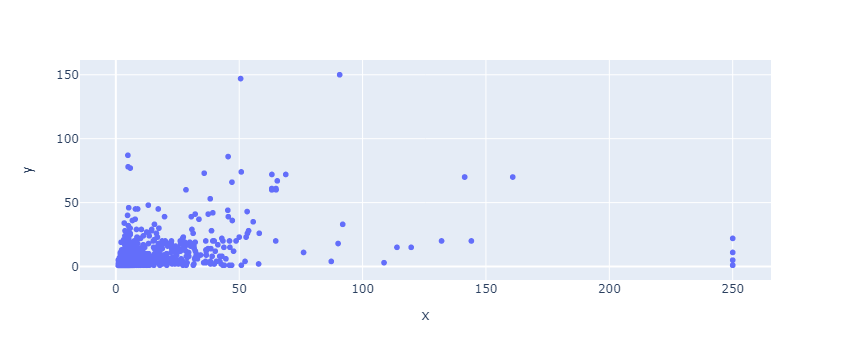

In [126]:
px.scatter(x = y.cpu().detach().numpy(), y = t.cpu().detach().numpy())

#### 3.2.2.2. LightGBM

In [53]:
all_idx = range(len(task2y))
train_idx = random.sample(all_idx, int(len(task2y)*0.8))
test_idx = list(set(all_idx) - set(train_idx))

train_lgb = lgb.Dataset(task2X[train_idx].numpy(), task2y[train_idx].numpy())
eval_lgb = lgb.Dataset(task2X[test_idx].numpy(), task2y[test_idx].numpy())

In [54]:
params_lgb = dict(
            task="train",
            boosting_type="gbdt",
            objective="regression",
            metric="rmse",
            learning_rate=.05,
            force_col_wise=True,
            device='cpu',
            num_leaves=700,
            max_iter=2000,
            seed=seed,
            lambda_l1=.1,
            lambda_l2=.1,
            bagging_freq=10,
            bagging_seed=seed,
        )

evals_result = {}

model_lgb = lgb.train(
    params=params_lgb,
    train_set=train_lgb,
    valid_names=['train', 'valid'],
    valid_sets=[train_lgb, eval_lgb],
    early_stopping_rounds=20,
    evals_result=evals_result,
    #verbose_eval=self.verbose
)

preds_lgb = model_lgb.predict(task2X[test_idx].numpy())
res = mse(preds_lgb, task2y[test_idx].numpy())**.5
res

[LightGBM] [Info] Total Bins 196640
[LightGBM] [Info] Number of data points in the train set: 49213, number of used features: 804
[LightGBM] [Info] Start training from score 4.559629
[1]	train's rmse: 6.55231	valid's rmse: 6.50083
Training until validation scores don't improve for 20 rounds
[2]	train's rmse: 6.39261	valid's rmse: 6.37571
[3]	train's rmse: 6.23789	valid's rmse: 6.26565
[4]	train's rmse: 6.09823	valid's rmse: 6.1719
[5]	train's rmse: 5.96119	valid's rmse: 6.07472
[6]	train's rmse: 5.83412	valid's rmse: 5.99331
[7]	train's rmse: 5.7115	valid's rmse: 5.91509
[8]	train's rmse: 5.598	valid's rmse: 5.84353
[9]	train's rmse: 5.48843	valid's rmse: 5.77127
[10]	train's rmse: 5.3915	valid's rmse: 5.71376
[11]	train's rmse: 5.29552	valid's rmse: 5.66331
[12]	train's rmse: 5.20469	valid's rmse: 5.60712
[13]	train's rmse: 5.12017	valid's rmse: 5.56422
[14]	train's rmse: 5.03524	valid's rmse: 5.5259
[15]	train's rmse: 4.95805	valid's rmse: 5.49167
[16]	train's rmse: 4.88396	valid's r

4.948237266246878

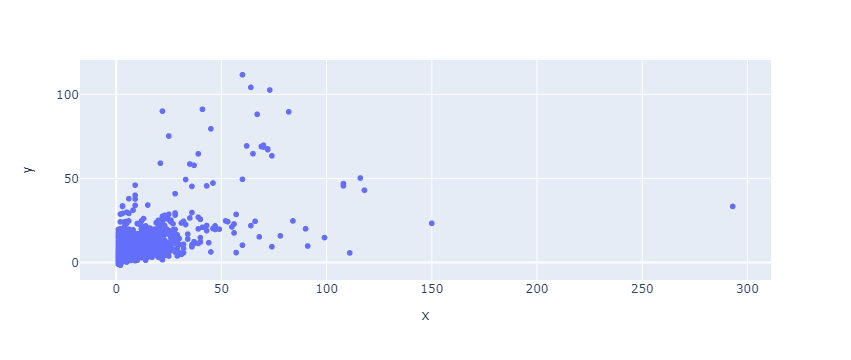

In [55]:
px.scatter(y=preds_lgb, x=task2y[test_idx].numpy())

## 3.3 Task3: Which contents do each topic have?

### 3.3.1. Data Preparation

In [14]:
%%time

target_lang = topics_rev[topics_rev.id.isin(target_topics_enc)].language
target_lang = list(set(target_lang) | {"en"})
positive = correlations_transform.query("t_language==c_language")
positive = positive[positive.t_language.isin(target_lang)]
positive = positive[positive.c_language.isin(target_lang)]
positive = positive[~positive.topic_id.isin(target_topics_enc)]
positive = positive[["topic_id", "content_id", "t_language"]]
positive["pair"] = 1

negative = []
for t in positive.topic_id.unique():
    res = positive[positive.topic_id==t][["content_id", "t_language"]]
    target_c_ids = content_rev[content_rev.language.isin(res.t_language)].id
    target_c_ids = set(target_c_ids) - set(res.content_id)
    c_ids = random.sample(list(target_c_ids), len(res))
    negative += [(t,c,0) for c in c_ids]
negative = pd.DataFrame(negative, columns=["topic_id", "content_id", "pair"])

data = pd.concat([positive.drop("t_language", axis=1), negative], axis=0, ignore_index=True)

X_train, X_test, y_train, y_test = tts(data[["topic_id", "content_id"]], data.pair,
                                       test_size=.1, stratify=data.pair,
                                       shuffle=True, random_state=seed)

del positive, negative, data, c_ids, target_c_ids, target_lang
gc.collect()

AttributeError: module 'gc' has no attribute 'gollect'

In [15]:
%%time

## train data
ttext, ctext, tnormal, cnormal = [], [], [], []
for i, row in X_train.iterrows():
    ttext.append(dr_topics[row.topic_id])
    ctext.append(dr_content[row.content_id])
    tnormal.append(torch.Tensor(task2X_backup[task2X_backup.index==row.topic_id].values.flatten()))
    cnormal.append(task1X_backup[row.content_id])

ttext = torch.stack(tuple(ttext))
ctext = torch.stack(tuple(ctext))
tnormal = torch.stack(tuple(tnormal))
cnormal = torch.stack(tuple(cnormal))

task3_train_dataset = TensorDataset(ttext, ctext, tnormal, cnormal, torch.Tensor(y_train.values))
task3_train_loader = DataLoader(task3_train_dataset,
                                batch_size=CFG.BATCH_SIZE,
                                shuffle=True)

## test data
ttext, ctext, tnormal, cnormal = [], [], [], []
for i, row in X_test.iterrows():
    ttext.append(dr_topics[row.topic_id])
    ctext.append(dr_content[row.content_id])
    tnormal.append(torch.Tensor(task2X_backup[task2X_backup.index==row.topic_id].values.flatten()))
    cnormal.append(task1X_backup[row.content_id])

ttext = torch.stack(tuple(ttext))
ctext = torch.stack(tuple(ctext))
tnormal = torch.stack(tuple(tnormal))
cnormal = torch.stack(tuple(cnormal))

task3_test_dataset = TensorDataset(ttext, ctext, tnormal, cnormal, torch.Tensor(y_test.values))
task3_test_loader = DataLoader(task3_test_dataset,
                                batch_size=CFG.BATCH_SIZE,
                                shuffle=True)

CPU times: user 1min 49s, sys: 1.32 s, total: 1min 51s
Wall time: 1min 50s


### 3.3.2. Modeling

In [361]:
%%time

class Task3(nn.Module):
    def __init__(self, text_features, topic_features, content_features):
        super(Task3, self).__init__()
        self.units_ttext = [text_features,512,256,256,64,128,32]
        self.units_ctext = [text_features,512,256,256,64,128,32]
        self.units_tnormal = [topic_features,512,256,256,64,128,32]
        self.units_cnormal = [content_features,512,256,256,64,128,32]
        self.units_concated = [self.units_ttext[-1]+self.units_tnormal[-1],128,256,256,64,32]
        
        self.ttext_l1_bn = nn.BatchNorm1d(self.units_ttext[0])
        self.ttext_l1 = nn.Linear(self.units_ttext[0], self.units_ttext[1])
        nn.init.xavier_normal_(self.ttext_l1.weight)
        self.ttext = nn.ModuleList([nn.Linear(self.units_ttext[i+1], self.units_ttext[i+2]) for i in range(len(self.units_ttext)-2)])
        self.ttext_bn = nn.ModuleList([nn.BatchNorm1d(self.units_ttext[i+1]) for i in range(len(self.units_ttext)-2)])

        self.ctext_l1_bn = nn.BatchNorm1d(self.units_ctext[0])
        self.ctext_l1 = nn.Linear(self.units_ctext[0], self.units_ctext[1])
        nn.init.xavier_normal_(self.ctext_l1.weight)
        self.ctext = nn.ModuleList([nn.Linear(self.units_ctext[i+1], self.units_ctext[i+2]) for i in range(len(self.units_ctext)-2)])
        self.ctext_bn = nn.ModuleList([nn.BatchNorm1d(self.units_ctext[i+1]) for i in range(len(self.units_ctext)-2)])

        self.tnormal_l1_bn = nn.BatchNorm1d(self.units_tnormal[0])
        self.tnormal_l1 = nn.Linear(self.units_tnormal[0], self.units_tnormal[1])
        nn.init.xavier_normal_(self.tnormal_l1.weight)
        self.tnormal = nn.ModuleList([nn.Linear(self.units_tnormal[i+1], self.units_tnormal[i+2]) for i in range(len(self.units_tnormal)-2)])
        self.tnormal_bn = nn.ModuleList([nn.BatchNorm1d(self.units_tnormal[i+1]) for i in range(len(self.units_tnormal)-2)])

        self.cnormal_l1_bn = nn.BatchNorm1d(self.units_cnormal[0])
        self.cnormal_l1 = nn.Linear(self.units_cnormal[0], self.units_cnormal[1])
        nn.init.xavier_normal_(self.cnormal_l1.weight)
        self.cnormal = nn.ModuleList([nn.Linear(self.units_cnormal[i+1], self.units_cnormal[i+2]) for i in range(len(self.units_cnormal)-2)])
        self.cnormal_bn = nn.ModuleList([nn.BatchNorm1d(self.units_cnormal[i+1]) for i in range(len(self.units_cnormal)-2)])

        self.concated_l1_bn = nn.BatchNorm1d(self.units_concated[0])
        self.concated_l1 = nn.Linear(self.units_concated[0], self.units_concated[1])
        nn.init.xavier_normal_(self.concated_l1.weight)
        self.concated = nn.ModuleList([nn.Linear(self.units_concated[i+1], self.units_concated[i+2]) for i in range(len(self.units_concated)-2)])
        self.concated_bn = nn.ModuleList([nn.BatchNorm1d(self.units_concated[i+1]) for i in range(len(self.units_concated)-2)])
        self.concated_last_layer = nn.Linear(self.units_concated[-1], 1)
        
    def forward(self, ttext, ctext, tnormal, cnormal):
        """
        topic_text_features
        """
        ttext = F.leaky_relu(self.ttext_l1(self.ttext_l1_bn(ttext)))
        for l, b in zip(self.ttext, self.ttext_bn):
            ttext = F.leaky_relu(l(b(ttext)))
        
        """
        content_text_features
        """
        ctext = F.leaky_relu(self.ctext_l1(self.ctext_l1_bn(ctext)))
        for l, b in zip(self.ctext, self.ctext_bn):
            ctext = F.leaky_relu(l(b(ctext)))
            
        """
        topic_normal_features
        """
        tnormal = F.leaky_relu(self.tnormal_l1(self.tnormal_l1_bn(tnormal)))
        for l, b in zip(self.tnormal, self.tnormal_bn):
            tnormal = F.leaky_relu(l(b(tnormal)))

        """
        content_normal_features
        """
        cnormal = F.leaky_relu(self.cnormal_l1(self.cnormal_l1_bn(cnormal)))
        for l, b in zip(self.cnormal, self.cnormal_bn):
            cnormal = F.leaky_relu(l(b(cnormal)))

        """
        concat networks
        """
        text = torch.mul(ttext, ctext)
        normal = torch.mul(tnormal, cnormal)
        x = torch.cat([text, normal], dim=1)
        x = F.leaky_relu(self.concated_l1(self.concated_l1_bn(x)))
        for l, b in zip(self.concated, self.concated_bn):
            x = F.leaky_relu(l(b(x)))
        x = F.sigmoid(self.concated_last_layer(x)).squeeze()
        return x

    
task3 = Task3(dr_topics.shape[1], task2X_backup.shape[1], task1X_backup.shape[1])
task3.cuda();

loss_func = nn.BCELoss()
optimizer = torch.optim.Adam(task3.parameters(), lr=.01)

loss_trains, loss_tests, accuracy_trains, accuracy_tests = [], [], [], []
early_stopping_count = 0

for epoch in tqdm(range(CFG.EPOCHS)):
    #"""
    #train
    #"""
    task3.train()
    preds = []
    loss_train = 0
    for j, (ttext, ctext, tnormal, cnormal, t) in enumerate(task3_train_loader):
        ttext, ctext, tnormal, cnormal, t = ttext.cuda(), ctext.cuda(), tnormal.cuda(), cnormal.cuda(), t.cuda()
        y = task3(ttext, ctext, tnormal, cnormal)
        preds += y
        true_values += t
        loss = loss_func(y, t)
        loss_train += loss.item()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    loss_train /= j+1
    loss_trains.append(loss_train)
    y = torch.stack(preds).squeeze()
    t = torch.stack(true_values).squeeze()
    accuracy_train = (torch.sum((y > CFG.THRESHOLD)==t) / y.shape[0]).item()
    accuracy_trains.append(accuracy_train)
    
    #"""
    #test
    #"""
    task3.eval()
    preds = []
    true_values = []
    loss_test = 0
    for j, (ttext, ctext, tnormal, cnormal, t) in enumerate(task3_test_loader):
        ttext, ctext, tnormal, cnormal, t = ttext.cuda(), ctext.cuda(), tnormal.cuda(), cnormal.cuda(), t.cuda()
        y = task3(ttext, ctext, tnormal, cnormal)
        preds += y
        true_values += t
        loss = loss_func(y, t)
        loss_test += loss.item()
    loss_test /= j+1
    loss_tests.append(loss_test)
    y = torch.stack(preds).squeeze()
    t = torch.stack(true_values).squeeze()
    accuracy_test = (torch.sum((y > CFG.THRESHOLD)==t) / y.shape[0]).item()
    
    print(f"Epoch: {epoch+1}, TrainLoss: {loss_train:.4f}, TestLoss: {loss_test:.4f}, TrainAcc: {accuracy_train:.4f}, TestAcc: {accuracy_test:.4f}.")
    print(f"test y: {y.cpu().detach().numpy()}")
    
    if len(accuracy_tests) > 0:
        best_score_before = max(accuracy_tests)
    else:
        best_score_before = None
    accuracy_tests.append(accuracy_test)
    if (max(accuracy_tests) == accuracy_test) and (best_score_before != accuracy_test):
        early_stopping_count = 0
        torch.save(task3.state_dict(), "checkpoint/task3_bestmodel.pth")
    else:
        early_stopping_count += 1
    
    if early_stopping_count == CFG.EARLY_STOPPING_ROUNDS:
        best_epoch = epoch - CFG.EARLY_STOPPING_ROUNDS
        early_stopping_message =\
        f"Best Epoch: {best_epoch+1}" + f", TrainLoss: {loss_trains[best_epoch]:.4f}"\
        + f", TestLoss: {loss_tests[best_epoch]:.4f}" + f", TrainAcc: {accuracy_trains[best_epoch]:.4f}"\
        + f", TestAcc: {accuracy_tests[best_epoch]:.4f}."
        print("!!!Early Stopping !!!")
        print(early_stopping_message)
        task3.load_state_dict(torch.load("checkpoint/task3_bestmodel.pth"))
        break

  2%|▏         | 1/50 [00:58<48:06, 58.92s/it]

Epoch: 1, TrainLoss: 0.4778, TestLoss: 0.4911, TrainAcc: 0.5000, TestAcc: 0.7844.
test y: [0.01234369 0.7802182  0.5931869  ... 0.6630926  0.80000234 0.8005086 ]


  4%|▍         | 2/50 [01:59<47:44, 59.68s/it]

Epoch: 2, TrainLoss: 0.3969, TestLoss: 0.4011, TrainAcc: 0.7844, TestAcc: 0.8206.
test y: [7.9571742e-01 4.0685543e-01 8.0289328e-01 ... 1.6233795e-04 7.6629398e-08
 8.3208477e-01]


  6%|▌         | 3/50 [02:57<46:11, 58.97s/it]

Epoch: 3, TrainLoss: 0.3707, TestLoss: 0.3843, TrainAcc: 0.8206, TestAcc: 0.8283.
test y: [0.53447545 0.8965003  0.02632424 ... 0.02357984 0.7864412  0.28924304]


  8%|▊         | 4/50 [03:55<44:54, 58.58s/it]

Epoch: 4, TrainLoss: 0.3514, TestLoss: 0.3741, TrainAcc: 0.8283, TestAcc: 0.8405.
test y: [0.67583793 0.8014081  0.68849623 ... 0.02230043 0.37163693 0.81760186]


 10%|█         | 5/50 [04:52<43:28, 57.98s/it]

Epoch: 5, TrainLoss: 0.3397, TestLoss: 0.4940, TrainAcc: 0.8405, TestAcc: 0.8461.
test y: [8.3916456e-01 8.5363013e-01 8.1563258e-01 ... 2.0595262e-04 9.2503053e-01
 2.7901235e-05]


 12%|█▏        | 6/50 [05:50<42:30, 57.96s/it]

Epoch: 6, TrainLoss: 0.3255, TestLoss: 0.4020, TrainAcc: 0.8461, TestAcc: 0.8440.
test y: [6.4565229e-01 1.3403071e-03 8.2137221e-01 ... 1.6451173e-35 2.0102875e-02
 2.2327539e-04]


 14%|█▍        | 7/50 [06:47<41:21, 57.72s/it]

Epoch: 7, TrainLoss: 0.3147, TestLoss: 0.4675, TrainAcc: 0.8440, TestAcc: 0.8491.
test y: [8.1199640e-01 8.1401771e-01 3.1168423e-05 ... 7.9991931e-01 1.4464457e-05
 4.2008538e-05]


 16%|█▌        | 8/50 [07:44<40:17, 57.56s/it]

Epoch: 8, TrainLoss: 0.3047, TestLoss: 0.4006, TrainAcc: 0.8491, TestAcc: 0.8620.
test y: [2.3517023e-05 9.6188128e-01 4.9346731e-05 ... 6.4414728e-01 8.6225456e-01
 7.0524395e-01]


 18%|█▊        | 9/50 [08:41<39:09, 57.29s/it]

Epoch: 9, TrainLoss: 0.2982, TestLoss: 0.4573, TrainAcc: 0.8620, TestAcc: 0.8646.
test y: [7.1506077e-01 8.3406889e-01 7.6777947e-01 ... 4.2021558e-05 2.5821581e-07
 2.5262523e-06]


 20%|██        | 10/50 [09:38<38:07, 57.18s/it]

Epoch: 10, TrainLoss: 0.2898, TestLoss: 0.4126, TrainAcc: 0.8646, TestAcc: 0.8644.
test y: [0.8940986  0.938316   0.89525753 ... 0.94131565 0.66590893 0.9439484 ]


 22%|██▏       | 11/50 [10:35<37:08, 57.15s/it]

Epoch: 11, TrainLoss: 0.2841, TestLoss: 0.4383, TrainAcc: 0.8644, TestAcc: 0.8663.
test y: [0.5382977  0.80049026 0.40064067 ... 0.02800012 0.5830691  0.9479553 ]


 24%|██▍       | 12/50 [11:32<36:12, 57.18s/it]

Epoch: 12, TrainLoss: 0.2802, TestLoss: 0.3775, TrainAcc: 0.8663, TestAcc: 0.8713.
test y: [4.1401061e-01 5.6925488e-01 6.9583926e-05 ... 3.8154551e-01 7.4578094e-04
 3.0025601e-02]


 26%|██▌       | 13/50 [12:30<35:19, 57.30s/it]

Epoch: 13, TrainLoss: 0.2720, TestLoss: 0.3608, TrainAcc: 0.8713, TestAcc: 0.8740.
test y: [9.7592258e-01 8.6365181e-01 9.2835951e-01 ... 7.9237938e-01 3.3346015e-07
 5.7623923e-01]


 28%|██▊       | 14/50 [13:28<34:34, 57.61s/it]

Epoch: 14, TrainLoss: 0.2652, TestLoss: 0.5130, TrainAcc: 0.8740, TestAcc: 0.8241.
test y: [1.2413709e-02 6.9411147e-01 4.3228250e-05 ... 8.0723029e-01 2.0071323e-01
 8.5418804e-05]


 30%|███       | 15/50 [14:26<33:43, 57.81s/it]

Epoch: 15, TrainLoss: 0.2607, TestLoss: 0.4758, TrainAcc: 0.8241, TestAcc: 0.8683.
test y: [4.7751246e-06 9.4288445e-01 9.6990329e-01 ... 3.0101661e-05 8.9262649e-05
 2.9182194e-02]


 32%|███▏      | 16/50 [15:24<32:43, 57.74s/it]

Epoch: 16, TrainLoss: 0.2520, TestLoss: 0.4848, TrainAcc: 0.8683, TestAcc: 0.8788.
test y: [1.1519028e-06 9.0742725e-01 3.4582828e-07 ... 7.5291209e-05 1.8172812e-01
 3.5565984e-01]


 34%|███▍      | 17/50 [16:23<32:00, 58.20s/it]

Epoch: 17, TrainLoss: 0.2454, TestLoss: 0.4271, TrainAcc: 0.8788, TestAcc: 0.8848.
test y: [8.8461185e-01 9.2493510e-01 8.7977380e-01 ... 3.4832563e-05 6.6432846e-01
 9.8201120e-01]


 36%|███▌      | 18/50 [17:21<31:02, 58.21s/it]

Epoch: 18, TrainLoss: 0.2422, TestLoss: 0.4173, TrainAcc: 0.8848, TestAcc: 0.8852.
test y: [3.8956812e-05 9.7166294e-01 7.4487883e-07 ... 8.4511083e-01 2.8800648e-01
 8.3895391e-01]


 38%|███▊      | 19/50 [18:21<30:14, 58.54s/it]

Epoch: 19, TrainLoss: 0.2351, TestLoss: 0.4140, TrainAcc: 0.8852, TestAcc: 0.8883.
test y: [6.7020637e-01 9.4988763e-01 6.5999389e-01 ... 9.1509110e-01 1.6310798e-08
 1.9286759e-05]


 40%|████      | 20/50 [19:18<29:04, 58.16s/it]

Epoch: 20, TrainLoss: 0.2312, TestLoss: 0.4246, TrainAcc: 0.8883, TestAcc: 0.8912.
test y: [6.5850759e-01 2.9699837e-05 9.1571891e-01 ... 6.0629064e-01 1.5081363e-06
 9.7148931e-01]


 42%|████▏     | 21/50 [20:16<28:05, 58.11s/it]

Epoch: 21, TrainLoss: 0.2274, TestLoss: 0.4077, TrainAcc: 0.8912, TestAcc: 0.8926.
test y: [1.0747756e-03 9.8191696e-01 1.1725213e-06 ... 9.6930802e-01 9.2884994e-01
 4.4760345e-06]


 44%|████▍     | 22/50 [21:13<26:57, 57.76s/it]

Epoch: 22, TrainLoss: 0.2221, TestLoss: 0.3943, TrainAcc: 0.8926, TestAcc: 0.8943.
test y: [1.8046283e-08 8.0780745e-01 7.3905084e-03 ... 2.7076092e-06 7.8685850e-02
 5.8194991e-02]


 46%|████▌     | 23/50 [22:10<25:58, 57.72s/it]

Epoch: 23, TrainLoss: 0.2178, TestLoss: 0.4632, TrainAcc: 0.8943, TestAcc: 0.8941.
test y: [9.5658427e-01 8.2400709e-01 8.4813964e-01 ... 1.7542999e-04 9.1578680e-01
 6.8903937e-05]


 48%|████▊     | 24/50 [23:10<25:15, 58.29s/it]

Epoch: 24, TrainLoss: 0.2135, TestLoss: 0.3815, TrainAcc: 0.8941, TestAcc: 0.8951.
test y: [6.9809079e-01 8.5599922e-06 9.1790050e-01 ... 9.5943171e-01 4.2631578e-07
 9.9083179e-01]


 50%|█████     | 25/50 [24:08<24:11, 58.08s/it]

Epoch: 25, TrainLoss: 0.2092, TestLoss: 0.3938, TrainAcc: 0.8951, TestAcc: 0.8970.
test y: [9.1223961e-01 2.9828787e-04 5.8238061e-06 ... 7.6773994e-02 1.0900992e-01
 8.6135703e-01]


 52%|█████▏    | 26/50 [25:05<23:09, 57.88s/it]

Epoch: 26, TrainLoss: 0.2050, TestLoss: 0.4411, TrainAcc: 0.8970, TestAcc: 0.8913.
test y: [1.2015306e-05 9.6596301e-01 1.5825141e-02 ... 9.5724797e-01 9.5292288e-01
 9.3781430e-01]


 54%|█████▍    | 27/50 [26:02<22:04, 57.57s/it]

Epoch: 27, TrainLoss: 0.2012, TestLoss: 0.4589, TrainAcc: 0.8913, TestAcc: 0.8950.
test y: [5.0356913e-01 9.9245572e-01 8.8063568e-01 ... 2.7173743e-05 9.8656344e-01
 1.6718748e-06]


 56%|█████▌    | 28/50 [26:59<21:04, 57.49s/it]

Epoch: 28, TrainLoss: 0.1971, TestLoss: 0.4240, TrainAcc: 0.8950, TestAcc: 0.8968.
test y: [8.5739362e-01 8.7057894e-01 3.7929107e-04 ... 6.7228614e-03 8.5891783e-01
 1.8124586e-02]


 58%|█████▊    | 29/50 [27:58<20:15, 57.89s/it]

Epoch: 29, TrainLoss: 0.1942, TestLoss: 0.4438, TrainAcc: 0.8968, TestAcc: 0.8881.
test y: [0.7113479  0.00282045 0.7949139  ... 0.00139911 0.77646756 0.9663208 ]


 60%|██████    | 30/50 [28:57<19:22, 58.13s/it]

Epoch: 30, TrainLoss: 0.1911, TestLoss: 0.5442, TrainAcc: 0.8881, TestAcc: 0.8984.
test y: [6.3342881e-08 3.2554352e-01 6.8774574e-12 ... 2.8305627e-05 3.5351442e-04
 9.6491230e-01]


 62%|██████▏   | 31/50 [29:55<18:22, 58.05s/it]

Epoch: 31, TrainLoss: 0.1858, TestLoss: 0.4258, TrainAcc: 0.8984, TestAcc: 0.8995.
test y: [3.6487577e-07 9.8764861e-01 8.4607804e-01 ... 9.1312242e-01 9.5213254e-06
 9.4296169e-01]


 64%|██████▍   | 32/50 [30:51<17:15, 57.53s/it]

Epoch: 32, TrainLoss: 0.1817, TestLoss: 0.4466, TrainAcc: 0.8995, TestAcc: 0.8987.
test y: [1.0959027e-04 1.3076033e-02 7.4164075e-01 ... 7.3374272e-04 6.4826071e-01
 9.9202466e-01]


 66%|██████▌   | 33/50 [31:50<16:25, 57.98s/it]

Epoch: 33, TrainLoss: 0.1784, TestLoss: 0.4316, TrainAcc: 0.8987, TestAcc: 0.8978.
test y: [8.9856237e-01 6.0626916e-03 8.9269865e-01 ... 5.6264689e-04 8.8203573e-01
 1.9677894e-03]


 68%|██████▊   | 34/50 [32:49<15:31, 58.23s/it]

Epoch: 34, TrainLoss: 0.1749, TestLoss: 0.5071, TrainAcc: 0.8978, TestAcc: 0.8986.
test y: [9.9012858e-01 1.0984495e-05 9.3818253e-01 ... 1.3505340e-01 8.4052563e-01
 1.0253199e-04]


 70%|███████   | 35/50 [33:47<14:33, 58.23s/it]

Epoch: 35, TrainLoss: 0.1716, TestLoss: 0.4634, TrainAcc: 0.8986, TestAcc: 0.8978.
test y: [5.0999716e-07 6.3055104e-01 9.1549784e-01 ... 9.7724915e-01 4.7766873e-01
 1.0681919e-04]


 70%|███████   | 35/50 [34:44<14:53, 59.57s/it]

Epoch: 36, TrainLoss: 0.1680, TestLoss: 0.4882, TrainAcc: 0.8978, TestAcc: 0.8979.
test y: [1.5855629e-06 1.1363055e-05 9.5196736e-01 ... 9.3220150e-01 1.3207834e-07
 4.5302431e-06]
!!!Early Stopping !!!
Best Epoch: 31, TrainLoss: 0.1858, TestLoss: 0.4258, TrainAcc: 0.8984, TestAcc: 0.8995.
CPU times: user 34min 10s, sys: 1min 4s, total: 35min 15s
Wall time: 34min 44s


In [23]:
%%time

class Task3(nn.Module):
    def __init__(self, text_features, topic_features, content_features):
        super(Task3, self).__init__()
        self.units_ttext = [text_features,512,256,256,64,128,32]
        self.units_ctext = [text_features,512,256,256,64,128,32]
        self.units_tnormal = [topic_features,512,256,256,64,128,32]
        self.units_cnormal = [content_features,512,256,256,64,128,32]
        self.units_concated = [self.units_ttext[-1]+self.units_tnormal[-1],128,256,256,64,32]
        
        self.ttext_l1_bn = nn.BatchNorm1d(self.units_ttext[0])
        self.ttext_l1 = nn.Linear(self.units_ttext[0], self.units_ttext[1])
        nn.init.xavier_normal_(self.ttext_l1.weight)
        self.ttext = nn.ModuleList([nn.Linear(self.units_ttext[i+1], self.units_ttext[i+2]) for i in range(len(self.units_ttext)-2)])
        self.ttext_bn = nn.ModuleList([nn.BatchNorm1d(self.units_ttext[i+1]) for i in range(len(self.units_ttext)-2)])

        self.ctext_l1_bn = nn.BatchNorm1d(self.units_ctext[0])
        self.ctext_l1 = nn.Linear(self.units_ctext[0], self.units_ctext[1])
        nn.init.xavier_normal_(self.ctext_l1.weight)
        self.ctext = nn.ModuleList([nn.Linear(self.units_ctext[i+1], self.units_ctext[i+2]) for i in range(len(self.units_ctext)-2)])
        self.ctext_bn = nn.ModuleList([nn.BatchNorm1d(self.units_ctext[i+1]) for i in range(len(self.units_ctext)-2)])

        self.tnormal_l1_bn = nn.BatchNorm1d(self.units_tnormal[0])
        self.tnormal_l1 = nn.Linear(self.units_tnormal[0], self.units_tnormal[1])
        nn.init.xavier_normal_(self.tnormal_l1.weight)
        self.tnormal = nn.ModuleList([nn.Linear(self.units_tnormal[i+1], self.units_tnormal[i+2]) for i in range(len(self.units_tnormal)-2)])
        self.tnormal_bn = nn.ModuleList([nn.BatchNorm1d(self.units_tnormal[i+1]) for i in range(len(self.units_tnormal)-2)])

        self.cnormal_l1_bn = nn.BatchNorm1d(self.units_cnormal[0])
        self.cnormal_l1 = nn.Linear(self.units_cnormal[0], self.units_cnormal[1])
        nn.init.xavier_normal_(self.cnormal_l1.weight)
        self.cnormal = nn.ModuleList([nn.Linear(self.units_cnormal[i+1], self.units_cnormal[i+2]) for i in range(len(self.units_cnormal)-2)])
        self.cnormal_bn = nn.ModuleList([nn.BatchNorm1d(self.units_cnormal[i+1]) for i in range(len(self.units_cnormal)-2)])

        self.concated_l1_bn = nn.BatchNorm1d(self.units_concated[0])
        self.concated_l1 = nn.Linear(self.units_concated[0], self.units_concated[1])
        nn.init.xavier_normal_(self.concated_l1.weight)
        self.concated = nn.ModuleList([nn.Linear(self.units_concated[i+1], self.units_concated[i+2]) for i in range(len(self.units_concated)-2)])
        self.concated_bn = nn.ModuleList([nn.BatchNorm1d(self.units_concated[i+1]) for i in range(len(self.units_concated)-2)])
        self.concated_last_layer = nn.Linear(self.units_concated[-1], 1)
        
    def forward(self, ttext, ctext, tnormal, cnormal):
        """
        topic_text_features
        """
        ttext = F.leaky_relu(self.ttext_l1(self.ttext_l1_bn(ttext)))
        for l, b in zip(self.ttext, self.ttext_bn):
            ttext = F.leaky_relu(l(b(ttext)))
        
        """
        content_text_features
        """
        ctext = F.leaky_relu(self.ctext_l1(self.ctext_l1_bn(ctext)))
        for l, b in zip(self.ctext, self.ctext_bn):
            ctext = F.leaky_relu(l(b(ctext)))
            
        """
        topic_normal_features
        """
        tnormal = F.leaky_relu(self.tnormal_l1(self.tnormal_l1_bn(tnormal)))
        for l, b in zip(self.tnormal, self.tnormal_bn):
            tnormal = F.leaky_relu(l(b(tnormal)))

        """
        content_normal_features
        """
        cnormal = F.leaky_relu(self.cnormal_l1(self.cnormal_l1_bn(cnormal)))
        for l, b in zip(self.cnormal, self.cnormal_bn):
            cnormal = F.leaky_relu(l(b(cnormal)))

        """
        concat networks
        """
        text = torch.mul(ttext, ctext)
        normal = torch.mul(tnormal, cnormal)
        x = torch.cat([text, normal], dim=1)
        x = F.leaky_relu(self.concated_l1(self.concated_l1_bn(x)))
        for l, b in zip(self.concated, self.concated_bn):
            x = F.leaky_relu(l(b(x)))
        x = F.sigmoid(self.concated_last_layer(x)).squeeze()
        return x

    
task3 = Task3(dr_topics.shape[1], task2X_backup.shape[1], task1X_backup.shape[1])
task3.cuda();

loss_func = nn.BCELoss()
optimizer = torch.optim.Adam(task3.parameters(), lr=.01)

loss_trains, loss_tests, accuracy_trains, accuracy_tests = [], [], [], []
early_stopping_count = 0

for epoch in tqdm(range(CFG.EPOCHS)):
    #"""
    #train
    #"""
    task3.train()
    preds = []
    true_values = []
    loss_train = 0
    for j, (ttext, ctext, tnormal, cnormal, t) in enumerate(task3_train_loader):
        ttext, ctext, tnormal, cnormal, t = ttext.cuda(), ctext.cuda(), tnormal.cuda(), cnormal.cuda(), t.cuda()
        y = task3(ttext, ctext, tnormal, cnormal)
        preds += y
        true_values += t
        loss = loss_func(y, t)
        loss_train += loss.item()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    loss_train /= j+1
    loss_trains.append(loss_train)
    y = torch.stack(preds).squeeze()
    t = torch.stack(true_values).squeeze()
    accuracy_train = (torch.sum((y > CFG.THRESHOLD)==t) / y.shape[0]).item()
    accuracy_trains.append(accuracy_train)
    
    #"""
    #test
    #"""
    task3.eval()
    preds = []
    true_values = []
    loss_test = 0
    for j, (ttext, ctext, tnormal, cnormal, t) in enumerate(task3_test_loader):
        ttext, ctext, tnormal, cnormal, t = ttext.cuda(), ctext.cuda(), tnormal.cuda(), cnormal.cuda(), t.cuda()
        y = task3(ttext, ctext, tnormal, cnormal)
        preds += y
        true_values += t
        loss = loss_func(y, t)
        loss_test += loss.item()
    loss_test /= j+1
    loss_tests.append(loss_test)
    y = torch.stack(preds).squeeze()
    t = torch.stack(true_values).squeeze()
    accuracy_test = (torch.sum((y > CFG.THRESHOLD)==t) / y.shape[0]).item()
    
    print(f"Epoch: {epoch+1}, TrainLoss: {loss_train:.4f}, TestLoss: {loss_test:.4f}, TrainAcc: {accuracy_train:.4f}, TestAcc: {accuracy_test:.4f}.")
    print(f"test y: {y.cpu().detach().numpy()}")
    
    if len(accuracy_tests) > 0:
        best_score_before = max(accuracy_tests)
    else:
        best_score_before = None
    accuracy_tests.append(accuracy_test)
    if (max(accuracy_tests) == accuracy_test) and (best_score_before != accuracy_test):
        early_stopping_count = 0
        torch.save(task3.state_dict(), "checkpoint/task3_bestmodel.pth")
    else:
        early_stopping_count += 1
    
    if early_stopping_count == CFG.EARLY_STOPPING_ROUNDS:
        best_epoch = epoch - CFG.EARLY_STOPPING_ROUNDS
        early_stopping_message =\
        f"Best Epoch: {best_epoch+1}" + f", TrainLoss: {loss_trains[best_epoch]:.4f}"\
        + f", TestLoss: {loss_tests[best_epoch]:.4f}" + f", TrainAcc: {accuracy_trains[best_epoch]:.4f}"\
        + f", TestAcc: {accuracy_tests[best_epoch]:.4f}."
        print("!!!Early Stopping !!!")
        print(early_stopping_message)
        task3.load_state_dict(torch.load("checkpoint/task3_bestmodel.pth"))
        break

  2%|▏         | 1/50 [02:58<2:25:48, 178.54s/it]

Epoch: 1, TrainLoss: 0.4805, TestLoss: 0.4646, TrainAcc: 0.7459, TestAcc: 0.7955.
test y: [8.7917346e-01 6.7971456e-01 4.8812285e-01 ... 8.9348042e-01 8.7102782e-04
 8.6881757e-01]


  4%|▍         | 2/50 [05:52<2:20:46, 175.97s/it]

Epoch: 2, TrainLoss: 0.4017, TestLoss: 0.4072, TrainAcc: 0.8047, TestAcc: 0.8149.
test y: [0.00698996 0.00153781 0.8004582  ... 0.12684388 0.00294138 0.30558   ]


  6%|▌         | 3/50 [08:38<2:14:15, 171.39s/it]

Epoch: 3, TrainLoss: 0.3700, TestLoss: 0.4813, TrainAcc: 0.8247, TestAcc: 0.8391.
test y: [8.4606135e-01 8.8999510e-01 8.7616843e-01 ... 2.3330640e-04 2.3445618e-04
 6.0655373e-01]


  8%|▊         | 4/50 [11:36<2:13:19, 173.91s/it]

Epoch: 4, TrainLoss: 0.3470, TestLoss: 0.3629, TrainAcc: 0.8397, TestAcc: 0.8474.
test y: [0.91841793 0.57851696 0.6523842  ... 0.9075756  0.5809686  0.8282013 ]


 10%|█         | 5/50 [14:06<2:03:56, 165.25s/it]

Epoch: 5, TrainLoss: 0.3331, TestLoss: 0.4303, TrainAcc: 0.8476, TestAcc: 0.8552.
test y: [6.0702568e-01 7.9826117e-01 2.0070063e-04 ... 9.5352852e-01 8.5787702e-01
 4.2128387e-01]


 12%|█▏        | 6/50 [16:35<1:57:17, 159.94s/it]

Epoch: 6, TrainLoss: 0.3203, TestLoss: 0.4421, TrainAcc: 0.8555, TestAcc: 0.8599.
test y: [2.9774592e-05 8.8931012e-01 1.8196712e-04 ... 8.3613902e-01 6.4350264e-03
 5.4401311e-04]


 14%|█▍        | 7/50 [19:05<1:52:08, 156.48s/it]

Epoch: 7, TrainLoss: 0.3093, TestLoss: 0.4093, TrainAcc: 0.8615, TestAcc: 0.8616.
test y: [8.6003441e-01 8.1476992e-01 1.9788347e-05 ... 3.0601146e-05 2.8482824e-05
 7.4933996e-05]


 16%|█▌        | 8/50 [22:03<1:54:25, 163.47s/it]

Epoch: 8, TrainLoss: 0.3023, TestLoss: 0.5504, TrainAcc: 0.8651, TestAcc: 0.8527.
test y: [0.96035296 0.2754323  0.53003526 ... 0.65993637 0.90355265 0.8859588 ]


 18%|█▊        | 9/50 [24:33<1:48:41, 159.06s/it]

Epoch: 9, TrainLoss: 0.2961, TestLoss: 0.3737, TrainAcc: 0.8687, TestAcc: 0.8680.
test y: [8.2050228e-01 2.5835494e-03 6.3085917e-04 ... 6.3929993e-01 4.8034368e-03
 8.4614390e-01]


 20%|██        | 10/50 [27:02<1:44:04, 156.11s/it]

Epoch: 10, TrainLoss: 0.2902, TestLoss: 0.7843, TrainAcc: 0.8719, TestAcc: 0.8657.
test y: [0.9505939  0.05262896 0.58438325 ... 0.5744169  0.9411466  0.94907457]


 22%|██▏       | 11/50 [29:34<1:40:36, 154.77s/it]

Epoch: 11, TrainLoss: 0.2824, TestLoss: 0.6180, TrainAcc: 0.8758, TestAcc: 0.8726.
test y: [9.6403795e-01 8.1828445e-01 6.2172574e-01 ... 8.2277876e-01 8.8523126e-01
 6.2965341e-06]


 24%|██▍       | 12/50 [32:27<1:41:28, 160.23s/it]

Epoch: 12, TrainLoss: 0.2778, TestLoss: 0.4524, TrainAcc: 0.8786, TestAcc: 0.8706.
test y: [0.8884227  0.8222145  0.00329778 ... 0.00150849 0.8616542  0.8530894 ]


 26%|██▌       | 13/50 [35:13<1:39:53, 161.97s/it]

Epoch: 13, TrainLoss: 0.2753, TestLoss: 0.4424, TrainAcc: 0.8801, TestAcc: 0.8737.
test y: [1.9575292e-03 1.5969037e-04 9.5616841e-01 ... 9.5931059e-01 1.5278372e-05
 8.4174335e-01]


 28%|██▊       | 14/50 [37:42<1:34:56, 158.23s/it]

Epoch: 14, TrainLoss: 0.2689, TestLoss: 0.5610, TrainAcc: 0.8832, TestAcc: 0.8754.
test y: [9.3977994e-01 9.1458249e-01 9.2143327e-01 ... 2.1289636e-05 8.5433251e-01
 1.0129209e-03]


 30%|███       | 15/50 [40:19<1:32:03, 157.82s/it]

Epoch: 15, TrainLoss: 0.2644, TestLoss: 0.4054, TrainAcc: 0.8858, TestAcc: 0.8785.
test y: [9.0548837e-01 9.4326794e-01 9.9290437e-01 ... 4.0087546e-04 5.7588672e-06
 3.4817362e-09]


 32%|███▏      | 16/50 [43:06<1:31:00, 160.61s/it]

Epoch: 16, TrainLoss: 0.2614, TestLoss: 0.4339, TrainAcc: 0.8875, TestAcc: 0.8707.
test y: [2.5670947e-06 9.0245926e-01 8.8097745e-01 ... 9.8197526e-01 9.0709502e-01
 2.0250714e-01]


 34%|███▍      | 17/50 [45:53<1:29:17, 162.36s/it]

Epoch: 17, TrainLoss: 0.2568, TestLoss: 0.4256, TrainAcc: 0.8897, TestAcc: 0.8793.
test y: [0.90726733 0.87065613 0.9236457  ... 0.93199944 0.9158256  0.00696129]


 36%|███▌      | 18/50 [48:36<1:26:44, 162.64s/it]

Epoch: 18, TrainLoss: 0.2521, TestLoss: 0.4638, TrainAcc: 0.8925, TestAcc: 0.8788.
test y: [6.0975206e-01 9.4681185e-01 3.1191126e-11 ... 6.8870968e-01 1.7199719e-07
 9.2491263e-01]


 38%|███▊      | 19/50 [51:22<1:24:37, 163.80s/it]

Epoch: 19, TrainLoss: 0.2486, TestLoss: 0.4063, TrainAcc: 0.8943, TestAcc: 0.8801.
test y: [9.6755433e-01 1.9550191e-02 6.9150298e-07 ... 9.9408251e-01 7.9190540e-01
 1.5607475e-04]


 40%|████      | 20/50 [53:51<1:19:36, 159.21s/it]

Epoch: 20, TrainLoss: 0.2438, TestLoss: 0.4268, TrainAcc: 0.8971, TestAcc: 0.8807.
test y: [0.9539181  0.9388038  0.42023918 ... 0.71471924 0.95619303 0.85589755]


 42%|████▏     | 21/50 [56:20<1:15:25, 156.07s/it]

Epoch: 21, TrainLoss: 0.2388, TestLoss: 0.4297, TrainAcc: 0.8998, TestAcc: 0.8794.
test y: [0.9712417  0.92639583 0.93174106 ... 0.5540656  0.92333394 0.87081194]


 44%|████▍     | 22/50 [58:48<1:11:46, 153.79s/it]

Epoch: 22, TrainLoss: 0.2343, TestLoss: 0.4294, TrainAcc: 0.9028, TestAcc: 0.8816.
test y: [0.3741219  0.94252086 0.96067554 ... 0.9754004  0.8584679  0.6996897 ]


 46%|████▌     | 23/50 [1:01:17<1:08:31, 152.27s/it]

Epoch: 23, TrainLoss: 0.2278, TestLoss: 0.4321, TrainAcc: 0.9068, TestAcc: 0.8864.
test y: [0.8643756  0.87512285 0.96632415 ... 0.91637313 0.8872161  0.74636286]


 48%|████▊     | 24/50 [1:03:47<1:05:41, 151.61s/it]

Epoch: 24, TrainLoss: 0.2234, TestLoss: 0.4094, TrainAcc: 0.9093, TestAcc: 0.8874.
test y: [8.6602992e-01 2.9439659e-07 9.2550611e-01 ... 9.1861689e-01 3.0187881e-01
 2.1287456e-06]


 50%|█████     | 25/50 [1:06:16<1:02:49, 150.76s/it]

Epoch: 25, TrainLoss: 0.2191, TestLoss: 0.4492, TrainAcc: 0.9117, TestAcc: 0.8890.
test y: [2.5621111e-05 9.2407382e-01 8.1930763e-01 ... 1.0424961e-04 7.7360439e-01
 9.3979245e-01]


 52%|█████▏    | 26/50 [1:08:44<1:00:02, 150.10s/it]

Epoch: 26, TrainLoss: 0.2130, TestLoss: 0.6069, TrainAcc: 0.9146, TestAcc: 0.8849.
test y: [1.5606147e-05 8.6614567e-01 9.0809387e-01 ... 7.9044294e-01 3.3366582e-01
 1.6276713e-04]


 54%|█████▍    | 27/50 [1:11:41<1:00:39, 158.25s/it]

Epoch: 27, TrainLoss: 0.2083, TestLoss: 0.5461, TrainAcc: 0.9176, TestAcc: 0.8920.
test y: [1.2862439e-11 7.3505509e-01 7.3969585e-01 ... 2.3820486e-07 6.6586983e-01
 9.1805267e-01]


 56%|█████▌    | 28/50 [1:14:33<59:28, 162.23s/it]  

Epoch: 28, TrainLoss: 0.2051, TestLoss: 0.3899, TrainAcc: 0.9191, TestAcc: 0.8890.
test y: [9.8596561e-01 4.9252844e-07 9.1036397e-01 ... 1.7009208e-03 5.2458188e-03
 9.8347670e-01]


 58%|█████▊    | 29/50 [1:17:02<55:26, 158.41s/it]

Epoch: 29, TrainLoss: 0.2007, TestLoss: 0.4842, TrainAcc: 0.9205, TestAcc: 0.8946.
test y: [8.2331866e-01 9.7298682e-01 3.7788436e-06 ... 2.9633873e-06 9.8901623e-01
 8.5832828e-01]


 60%|██████    | 30/50 [1:19:53<53:58, 161.95s/it]

Epoch: 30, TrainLoss: 0.1957, TestLoss: 0.3904, TrainAcc: 0.9234, TestAcc: 0.8941.
test y: [8.5229295e-01 9.6484572e-01 8.3805341e-01 ... 3.2982904e-02 1.5776059e-01
 1.2168050e-06]


 62%|██████▏   | 31/50 [1:22:22<50:05, 158.18s/it]

Epoch: 31, TrainLoss: 0.1929, TestLoss: 0.5702, TrainAcc: 0.9248, TestAcc: 0.8886.
test y: [2.3328584e-01 2.0129312e-09 2.6264691e-01 ... 9.7380257e-01 9.9680173e-01
 2.5436631e-07]


 64%|██████▍   | 32/50 [1:25:19<49:11, 163.95s/it]

Epoch: 32, TrainLoss: 0.1887, TestLoss: 0.4268, TrainAcc: 0.9262, TestAcc: 0.8945.
test y: [4.0917704e-04 8.6607677e-01 1.5672693e-03 ... 9.2791462e-01 4.8622075e-01
 9.7578532e-01]


 66%|██████▌   | 33/50 [1:27:48<45:09, 159.39s/it]

Epoch: 33, TrainLoss: 0.1847, TestLoss: 0.4041, TrainAcc: 0.9281, TestAcc: 0.8923.
test y: [8.5896224e-01 2.4576022e-07 9.4459713e-01 ... 1.1896573e-09 8.3197514e-03
 9.6334136e-01]


 66%|██████▌   | 33/50 [1:30:17<46:30, 164.17s/it]

Epoch: 34, TrainLoss: 0.1809, TestLoss: 0.4337, TrainAcc: 0.9297, TestAcc: 0.8941.
test y: [1.0951095e-06 8.0802649e-01 1.5816402e-10 ... 9.2214566e-01 1.3214772e-03
 9.8058081e-01]
!!!Early Stopping !!!
Best Epoch: 29, TrainLoss: 0.2007, TestLoss: 0.4842, TrainAcc: 0.9205, TestAcc: 0.8946.
CPU times: user 1h 23min 29s, sys: 7min 18s, total: 1h 30min 48s
Wall time: 1h 30min 17s


In [127]:
target_topics

0    t_00004da3a1b2
1    t_00068291e9a4
2    t_00069b63a70a
3    t_0006d41a73a8
4    t_4054df11a74e
Name: topic_id, dtype: object